# Optimizacion

#### Imports

In [1]:
import os
import random
import torch
import numpy as np
import matplotlib.pyplot as plt

from skimage.io import imread, imsave

from torchvision.transforms.functional import gaussian_blur
from torchmetrics.image import TotalVariation
from forward_autograd_batches.degradacion import *

# T : gaussian blur

In [84]:
#define objective function
def objetive_function_blur(x, y_obs): #, lam, regularization = 'None'):
    x = x.unsqueeze(0)
    y_k = gaussian_blur(x, kernel_size = (5,5), sigma = 3)
    y_obs = y_obs.unsqueeze(0)
    
    obj_function = torch.norm(y_obs - y_k)**2

    y_obs = y_obs.squeeze(0)
    x = x.squeeze(0)
    return obj_function

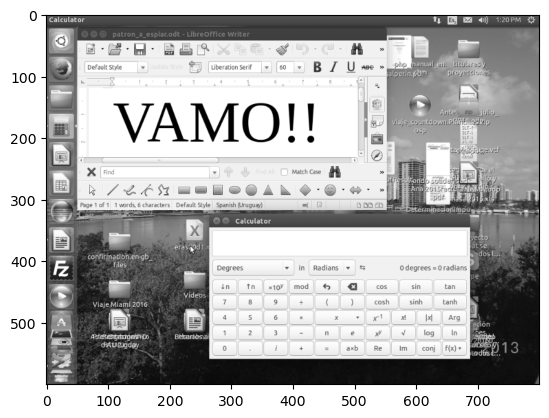

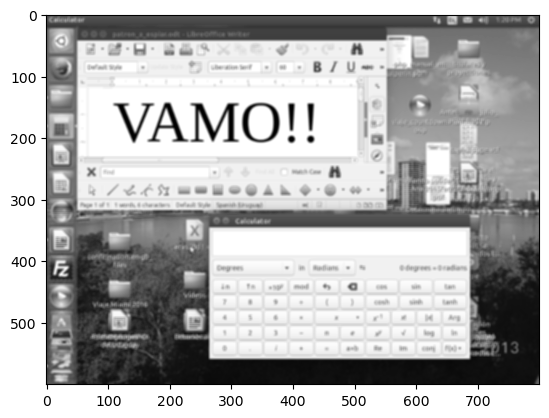

In [63]:
x_img = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True))

plt.imshow(x_img, cmap = 'gray')
plt.show()
x_img = x_img.unsqueeze(0)
blurred = gaussian_blur(x_img, kernel_size= (5,5), sigma = 2.5)
blurred = blurred.squeeze(0)
plt.imshow(blurred, cmap = 'gray')
plt.show()

In [217]:
def optimize_blur(x_gt, x_0, max_iter = 5000, eps = 1e-4, lr = 0.1):
    """
    Inputs:
    x_gt (torch tensor): ground truth image 
    x_0 (torch tensor): initial condition image with parameter 'requires_grad = True'
    max_iter (int): maximum number of iterations
    eps (float): minimum tolerance 
    lr (float): learning rate of iterative algorithm

    Output:
    x_opt (torch tensor): image result of optimizing objective function  
    """
        
    x_gt = x_gt.unsqueeze(0)
    #input image must be of shape (1, H, W)
    y_obs = gaussian_blur(x_gt, kernel_size= (5,5), sigma = 3)
    #output image is of shape (1, H, W) 
    y_obs = y_obs.squeeze(0)

    #y_obs_show = y_obs.clone()
    #y_obs_real = y_obs_show.detach().numpy().real
    #y_obs_imag = y_obs_show.detach().numpy().imag

    #store |x^{k+1} - x^{k}| 
    diff_x = torch.inf
    diff_x_record = []
    
    #store |x^{k} - x_gt| 
    diff_x_gt = torch.inf
    diff_x_gt_record = []

    #store objective function values at step k
    OF_record = []
    
    x_opt = x_0.detach()
    x_opt.requires_grad = True

    #define optimizer
    optimizer = torch.optim.Adam([x_opt], lr=lr)
    
    k = 0
    while (k < max_iter) and (diff_x > eps) and (diff_x_gt > eps):

        x_prev = x_opt.detach().clone()

        #empty gradients
        optimizer.zero_grad()
        #calculate objective function
        objective_func = objetive_function_blur(x_opt, y_obs)
        #backpropagation of gradients
        objective_func.backward(retain_graph=True)
        #update x_opt
        optimizer.step()

        OF_record.append(objective_func.detach())

        x_next = x_opt.detach().clone()

        diff_x_gt = torch.norm(x_next - x_prev).detach()
        diff_x_gt_record.append(diff_x_gt)

        diff_x = torch.norm(x_next - x_gt).detach()
        diff_x_record.append(diff_x)

        k = k + 1

        if (k % 1000 == 0):
            
            print("k: {}".format(k), end="\r", flush=True)
            print('objective function = {}'.format(objective_func))
            print('diff_x_gt: {}'.format(diff_x_gt))
            print('diff_x: {}'.format(diff_x))
            print('-----------')

            x_opt = x_opt.unsqueeze(0)
            y_opt = gaussian_blur(x_opt, kernel_size = (5,5), sigma = 3)
            y_opt = y_opt.squeeze(0)
            x_opt = x_opt.squeeze(0)

            y_opt_show = (y_opt - y_opt.min()) / (y_opt.max() - y_opt.min())
            y_obs_show = (y_obs - y_obs.min()) / (y_obs.max() - y_obs.min())

            _, axes = plt.subplots(1, 2, figsize=(12, 10))
            axes[0].imshow(y_opt_show.detach().numpy(), cmap = 'gray')
            axes[0].set_title("T(x_k). Iteration = {}".format(k))
            axes[1].imshow(y_obs_show.detach().numpy(), cmap = 'gray')
            axes[1].set_title("y_obs")
            plt.tight_layout()
            plt.show()
        
            plt.tight_layout()
            plt.show()
    
    return x_opt, OF_record, diff_x_gt_record, diff_x_record

In [214]:
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
#x_gt = x_gt.unsqueeze(0)
#x_0 = gaussian_blur(x_gt, kernel_size = (5,5), sigma = 2.0)
#x_gt = x_gt.squeeze(0)
#x_0 = x_0.squeeze(0)
x_0 = torch.zeros_like(x_gt)

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_blur(x_gt, x_0, max_iter = 800, eps = 1e-4, lr = 0.1)

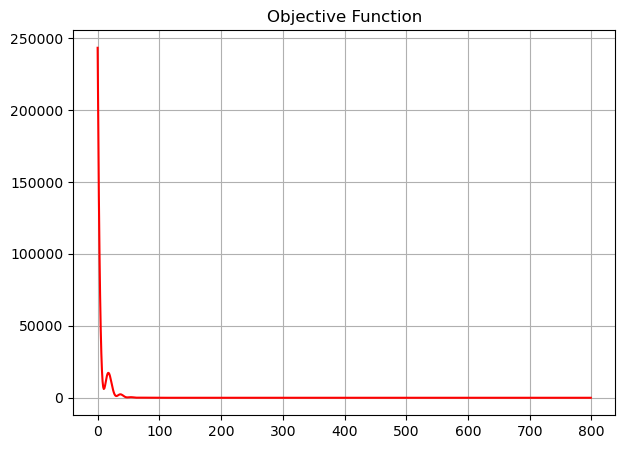

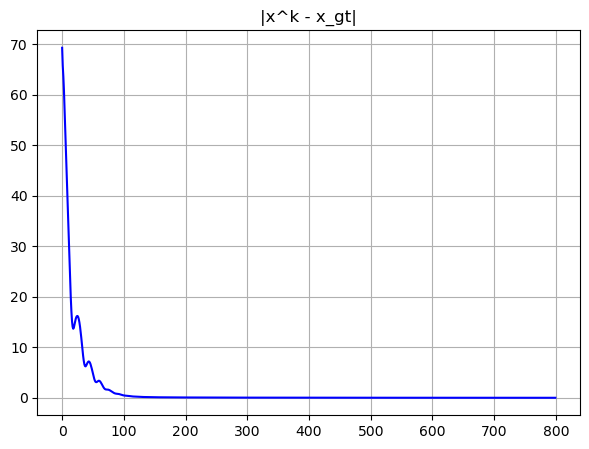

tensor(69.2820, dtype=torch.float64)


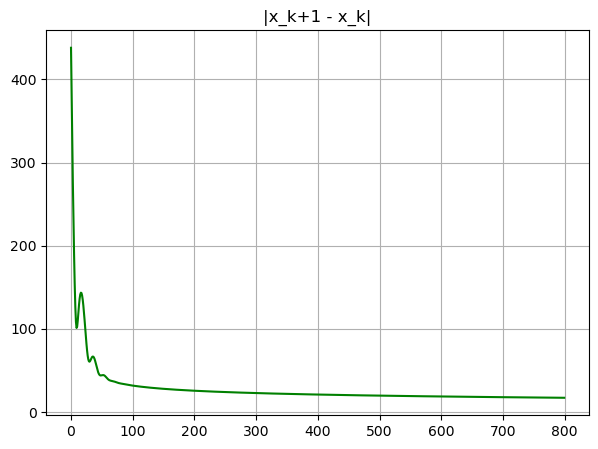

In [215]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

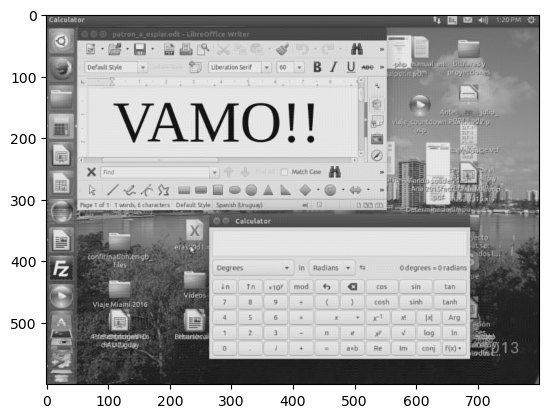

In [216]:
x_opt_final_norm = (x_opt_final - x_opt_final.min())/(x_opt_final.max() - x_opt_final.min())

plt.imshow(x_opt_final_norm.detach(), cmap = 'gray')


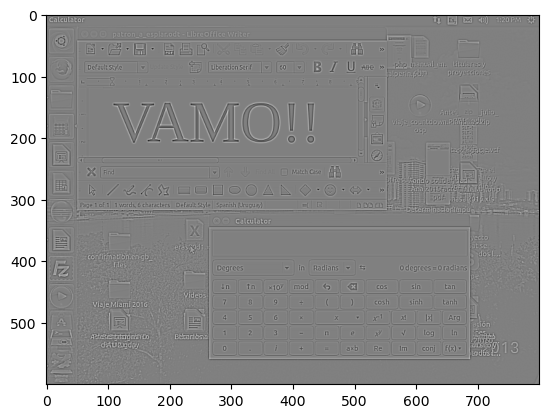

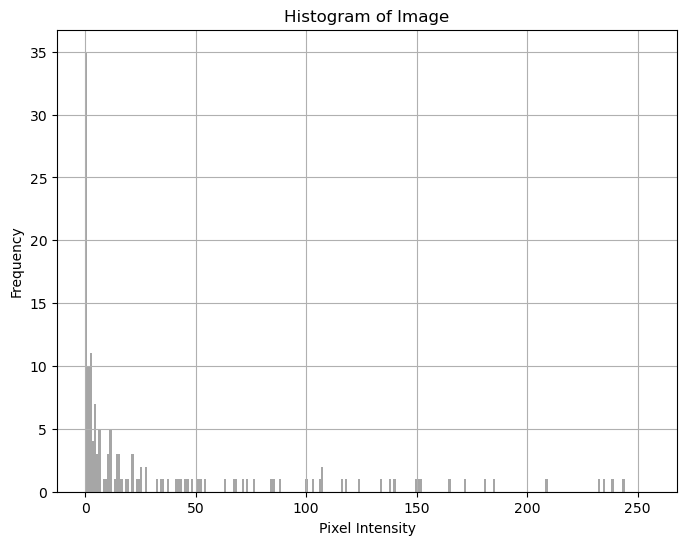

In [194]:
#plot histogram of difference between x_gt and x_0
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
x_gt_norm = (x_gt - x_gt.min())/(x_gt.max() - x_gt.min())

x_gt = x_gt.unsqueeze(0)
x_0 = gaussian_blur(x_gt, kernel_size = (5,5), sigma = 2.0)
x_gt = x_gt.squeeze(0)
x_0 = x_0.squeeze(0)

x_0_norm = (x_0 - x_0.min())/(x_0.max() - x_0.min())

difference = x_gt_norm - x_0_norm
difference_norm = (difference - difference.min())/(difference.max() - difference.min())

difference_show = difference_norm.detach()

plt.imshow(difference_show, cmap = 'gray')

#plot histogram of difference

difference_show_np = difference_show.numpy()

histogram, bins = np.histogram(difference_show_np, bins=256, range=(0, 1))
plt.figure(figsize=(8, 6))
plt.hist(histogram, bins=256, range=(0, 255), color='gray', alpha=0.7)
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.title('Histogram of Image')
plt.grid(True)
plt.show()

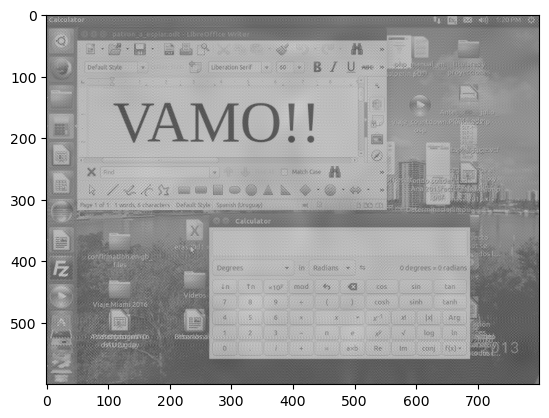

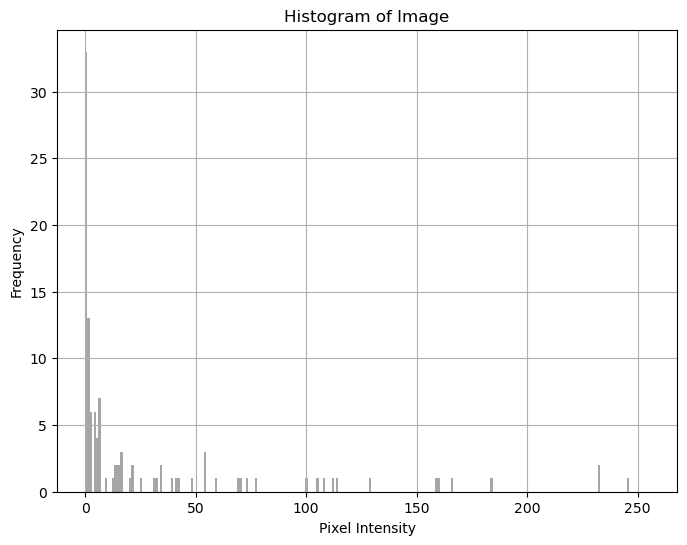

In [193]:
#plot histogram of difference between x_gt and x_opt_final
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
x_gt_norm = (x_gt - x_gt.min())/(x_gt.max() - x_gt.min())

x_opt_final_norm = (x_opt_final - x_opt_final.min())/(x_opt_final.max() - x_opt_final.min())

difference = x_gt_norm - x_opt_final_norm
difference_norm = (difference - difference.min())/(difference.max() - difference.min())

difference_show = difference_norm.detach()

plt.imshow(difference_show, cmap = 'gray')

#plot histogram of difference

difference_show_np = difference_show.numpy()

histogram, bins = np.histogram(difference_show_np, bins=256, range=(0, 1))
plt.figure(figsize=(8, 6))
plt.hist(histogram, bins=256, range=(0, 255), color='gray', alpha=0.7)
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.title('Histogram of Image')
plt.grid(True)
plt.show()

# T : hdmi degradation

In [2]:
#define regularization
eps = 1e-5
def regularization(x, reg = 'tv'):
    #total variation regularization
    if reg == 'tv':
        tv = TotalVariation()
        x = x.unsqueeze(0).unsqueeze(0)
        return tv(x)**2
    #l2 regularization
    if reg == 'l2':
        return torch.norm(x, p=2)**2
    #l1 regularization
    if reg == 'l1':
        resu = torch.sum(torch.square(x))
        return (resu + eps)**(1/2)
    #no regularization
    if reg == None:
        return 0

In [17]:
#define objective function
def objetive_function_hdmi(x, y_obs, reg, lam, k):
    print('Dynamic Range of x_opt on k = {}. = [{},{}]'.format(k, x.min(), x.max()))
    y_k = forward(x)
    obj_function = torch.norm(y_obs - y_k)**2 + lam * regularization(x, reg)
    return obj_function

In [18]:
def optimize_hdmi(x_gt, x_0, max_iter = 5000, eps = 1e-4, lr = 0.1, reg = 'tv', lam = 0.1, k_print = 1):
    """
    Inputs:
    x_gt (torch tensor): ground truth image 
    x_0 (torch tensor): initial condition image with parameter 'requires_grad = True'
    max_iter (int): maximum number of iterations
    eps (float): minimum tolerance for algorithm to stop
    lr (float): learning rate of iterative algorithm
    reg (char): 'tv' for total variation regularization, 'l2' for l2 regularization, 'l1' for l1 regularization, None for no regularization
    lam (float): regularization hiperparameter
    k_print (int): print results for multiples of k_print iterations

    Output:
    x_opt (torch tensor): image result of optimizing objective function  
    """

    y_obs = forward(x_gt)
    y_obs_abs = y_obs.abs()

    #store |x^{k+1} - x^{k}| 
    diff_x = torch.inf
    diff_x_record = []
    
    #store |x^{k} - x_gt| 
    diff_x_gt = torch.inf
    diff_x_gt_record = []

    #store objective function values at step k
    OF_record = []
    
    x_opt = x_0.detach()
    x_opt.requires_grad = True

    #print initial condition image
    plt.figure(figsize = (10,8))
    plt.imshow(x_opt.detach(), cmap = 'gray')
    plt.title('Initial condition x_0')
    plt.show()

    #define optimizer
    optimizer = torch.optim.Adam([x_opt], lr=lr)
    
    k = 0
    while (k < max_iter) and (diff_x > eps) and (diff_x_gt > eps):

        x_prev = x_opt.detach().clone()

        #empty gradients
        optimizer.zero_grad()
        #calculate objective function
        objective_func = objetive_function_hdmi(x_opt, y_obs, reg, lam, k)
        #backpropagation of gradients
        objective_func.backward(retain_graph=True)
        #update x_opt
        optimizer.step()

        OF_record.append(objective_func.detach())

        x_next = x_opt.detach().clone()

        diff_x_gt = torch.norm(x_next - x_prev).detach()
        diff_x_gt_record.append(diff_x_gt)

        diff_x = torch.norm(x_next - x_gt).detach()
        diff_x_record.append(diff_x)

        print("k: {}".format(k), end="\r", flush=True)
        k = k + 1

        if (k % k_print == 0):
            
            print("k: {}".format(k), end="\r", flush=True)
            print('objective function = {}'.format(objective_func))
            print('diff_x_gt: {}'.format(diff_x_gt))
            print('diff_x: {}'.format(diff_x))
            print('-----------')

            plt.figure(figsize = (10,8))
            plt.imshow(x_opt.detach().numpy(), cmap = 'gray')
            plt.title('x_opt')
            plt.show()

            y_opt = forward(x_opt)
            y_opt_abs = y_opt.abs()
            y_opt_show = (y_opt_abs - y_opt_abs.min()) / (y_opt_abs.max() - y_opt_abs.min())
            
            y_obs_show = (y_obs_abs - y_obs_abs.min()) / (y_obs_abs.max() - y_obs_abs.min())

            _, axes = plt.subplots(1, 2, figsize=(12, 10))
            axes[0].imshow(y_opt_show.detach().numpy(), cmap = 'gray')
            axes[0].set_title("T(x_k). Iteration = {}".format(k))
            axes[1].imshow(y_obs_show.detach().numpy(), cmap = 'gray')
            axes[1].set_title("y_obs")
            plt.tight_layout()
            plt.show()
        
            plt.tight_layout()
            plt.show()
    
    return x_opt, OF_record, diff_x_gt_record, diff_x_record

In [6]:
image_path = "./imagenes/VAMO.png"
img = np.asarray(Image.open(image_path))[:,:,0] #solo canal rojo
img_slice = torch.tensor(img, dtype=torch.float64, requires_grad=False)
imagen = forward(img_slice)

## image: white square

### optimization with no regularization

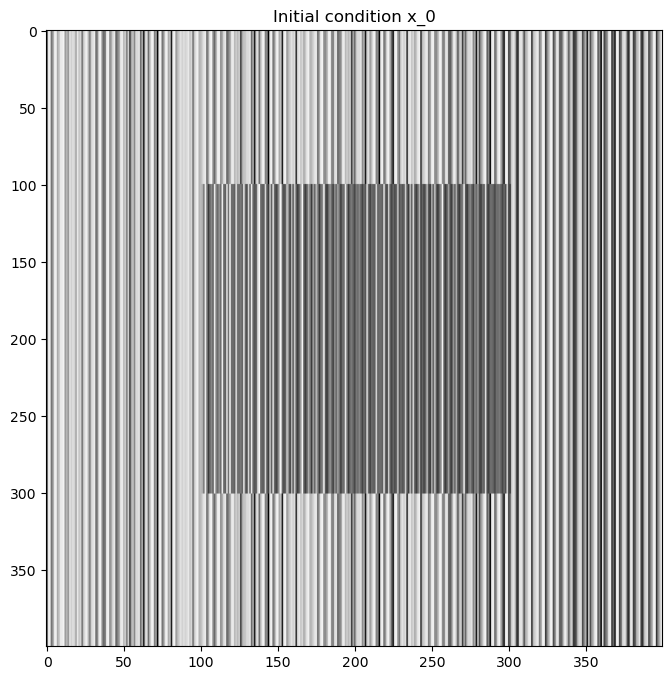

objective function = 32607.759765625
diff_x_gt: 2.229038715362549
diff_x: 192.2185162090061
-----------


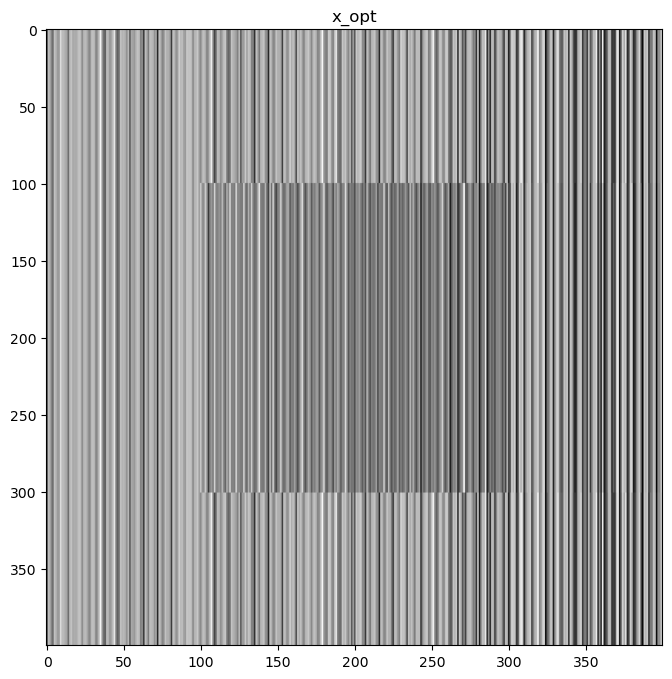

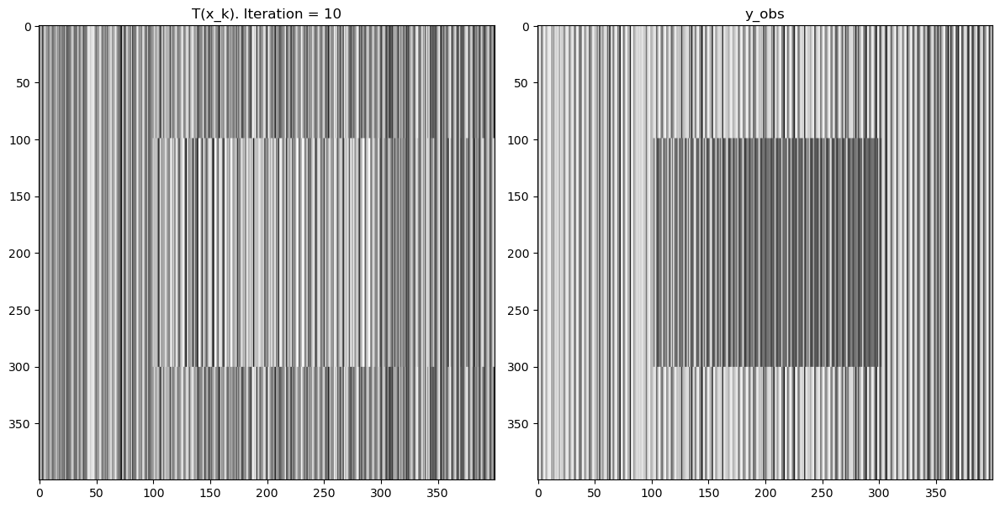

<Figure size 640x480 with 0 Axes>

objective function = 32084.75390625
diff_x_gt: 1.7623412609100342
diff_x: 187.05372322151473
-----------


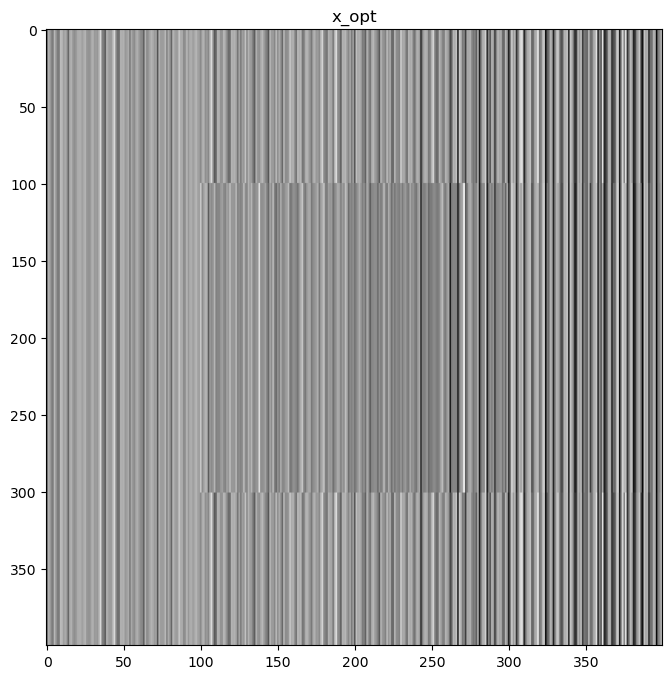

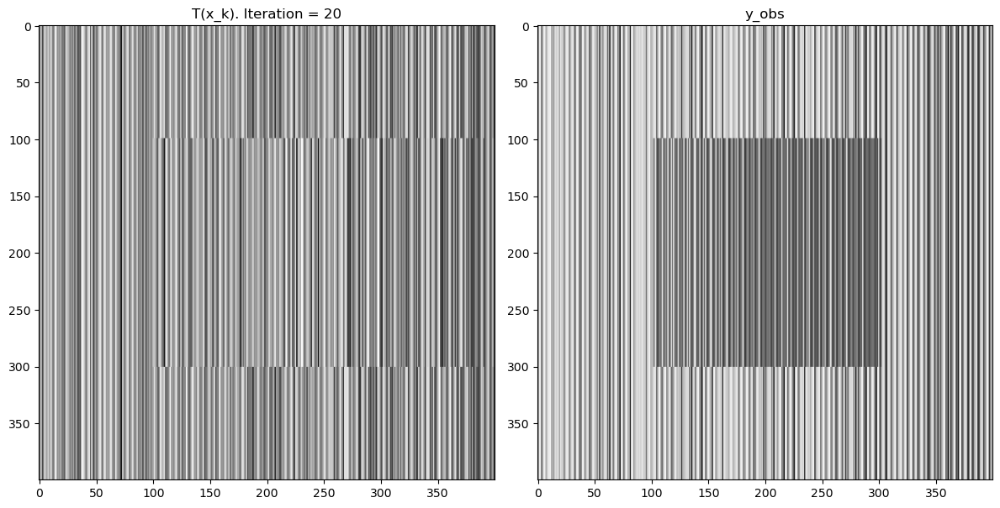

<Figure size 640x480 with 0 Axes>

objective function = 33390.23828125
diff_x_gt: 1.3924084901809692
diff_x: 185.49610902452244
-----------


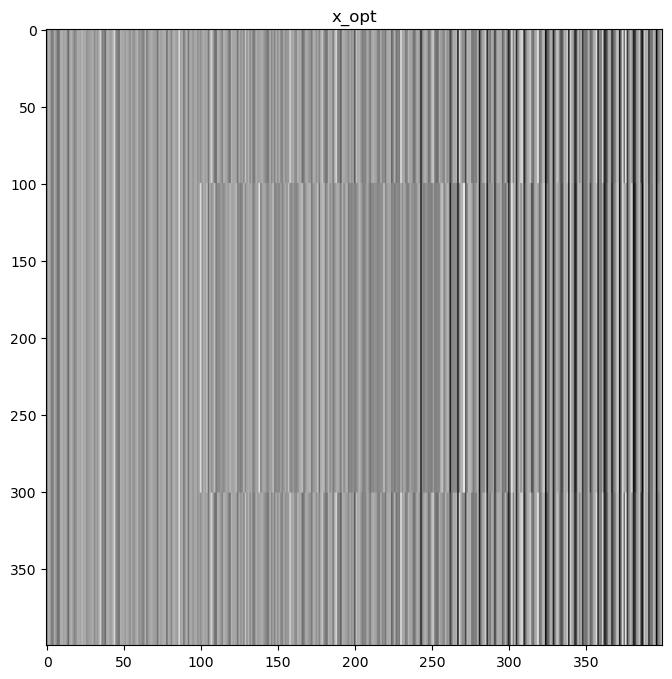

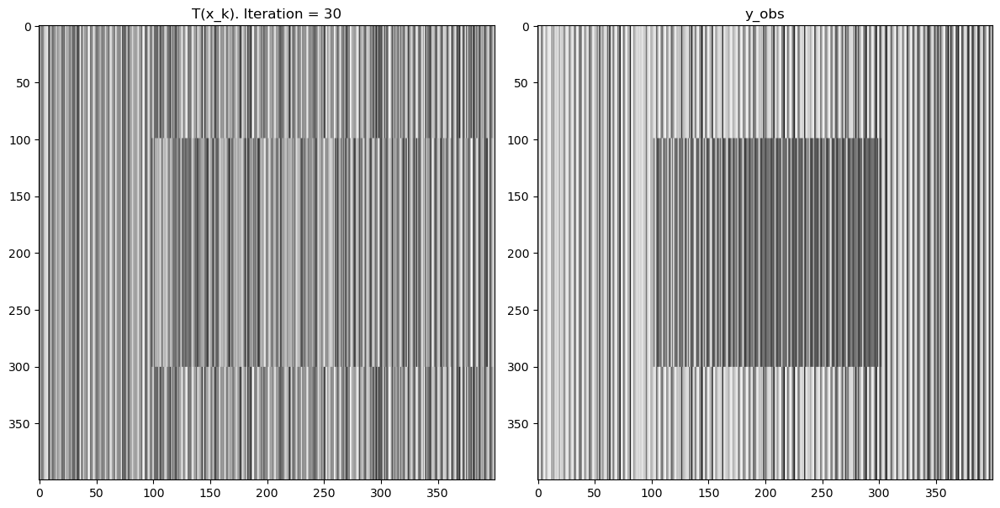

<Figure size 640x480 with 0 Axes>

objective function = 30158.5078125
diff_x_gt: 1.0752900838851929
diff_x: 185.5241705101676
-----------


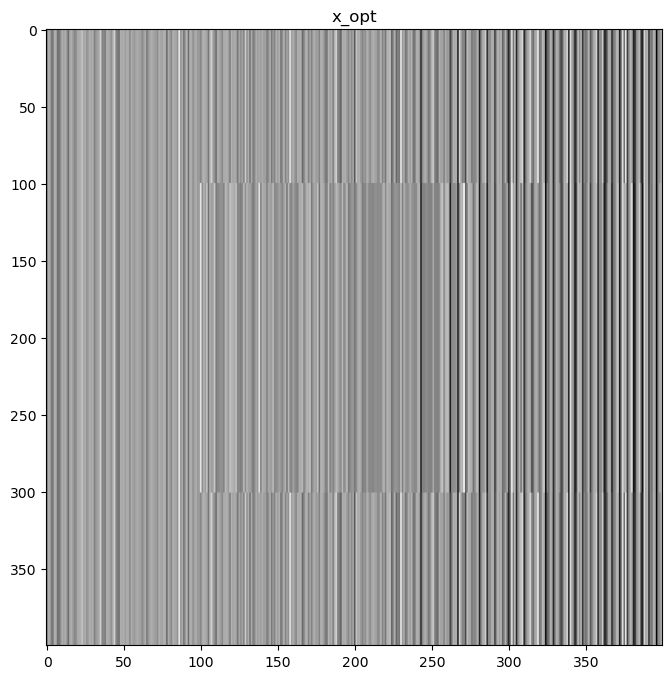

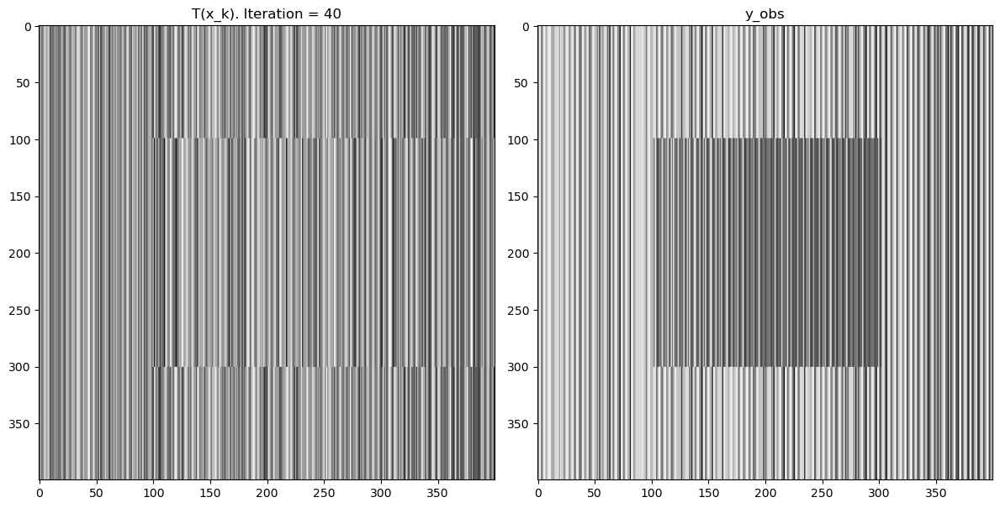

<Figure size 640x480 with 0 Axes>

objective function = 31483.265625
diff_x_gt: 1.086686134338379
diff_x: 185.47491138947268
-----------


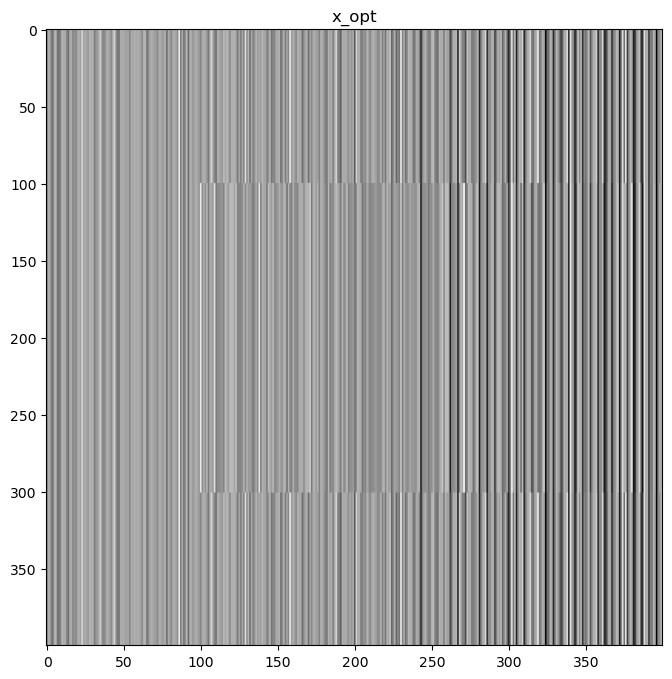

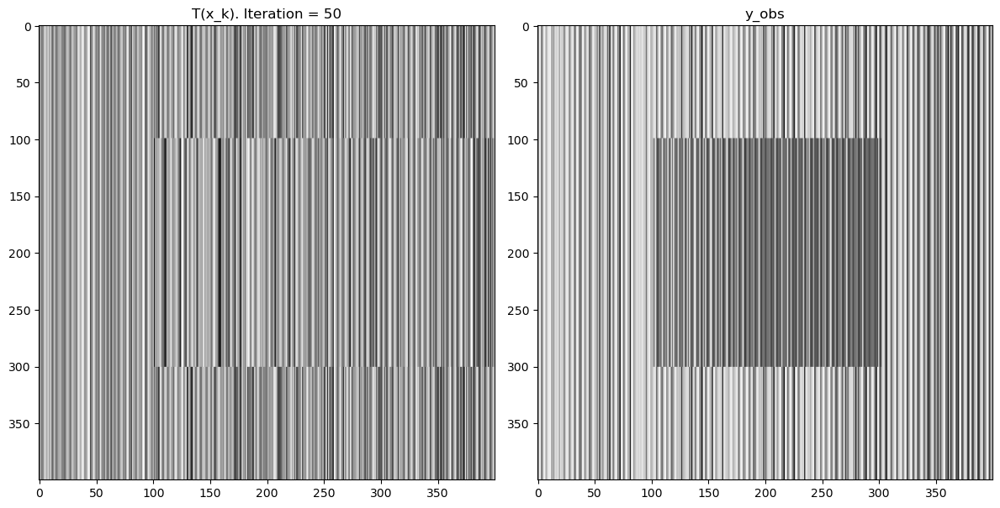

<Figure size 640x480 with 0 Axes>

In [14]:
#optimization with no regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "white_square.png"), as_gray=True), requires_grad= True)
y = forward(x_gt)
x_0 = y.abs()

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 50, eps = 1e-4, lr = 0.01, reg = None, lam = 0, k_print = 10 )

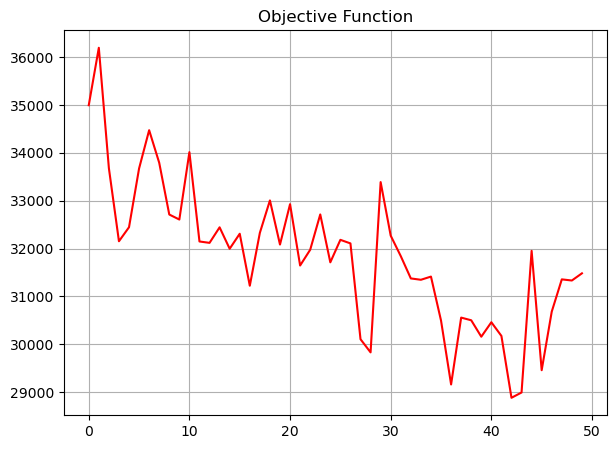

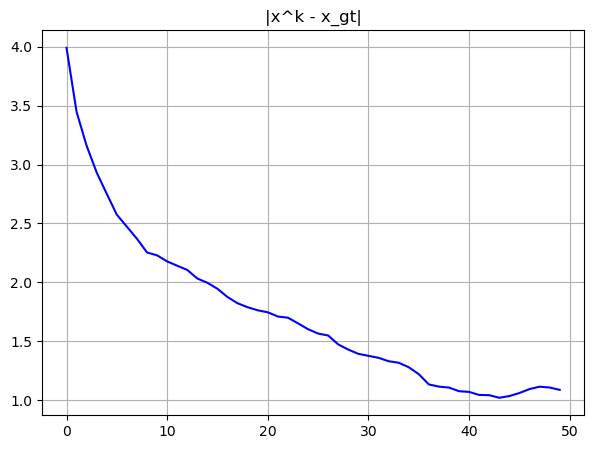

tensor(3.9924)


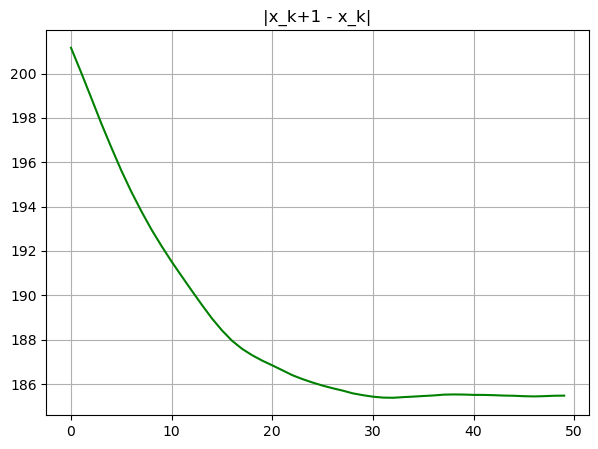

In [15]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

### optimization with tv regularization

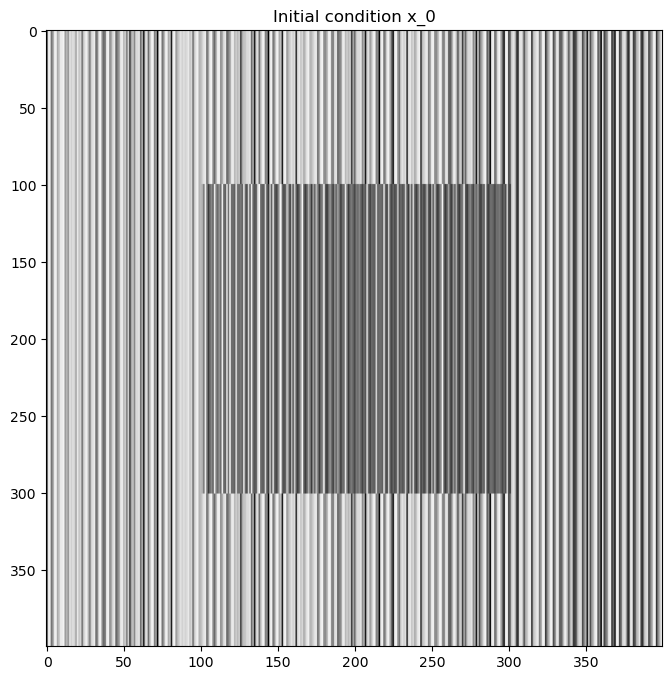

objective function = 32607.0859375
diff_x_gt: 2.276808500289917
diff_x: 191.92338722805502
-----------


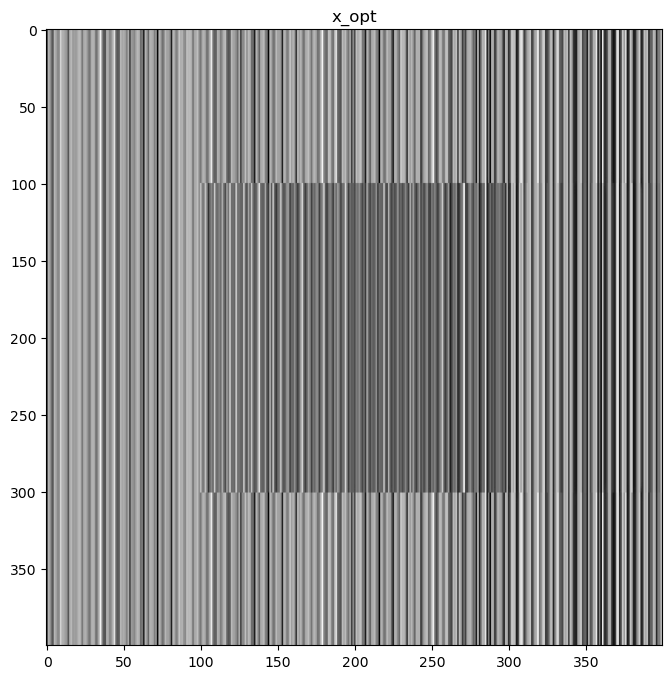

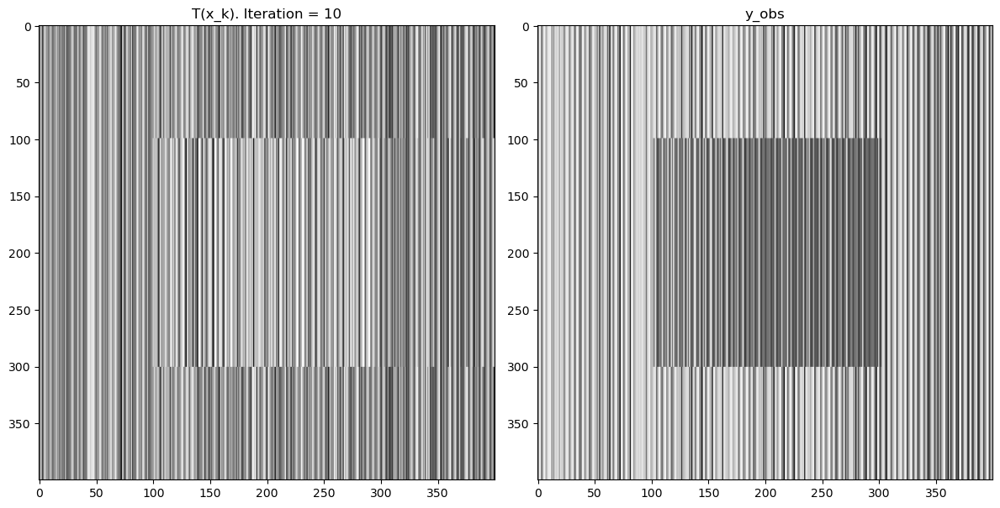

<Figure size 640x480 with 0 Axes>

objective function = 32223.443359375
diff_x_gt: 1.7497658729553223
diff_x: 187.02532527504815
-----------


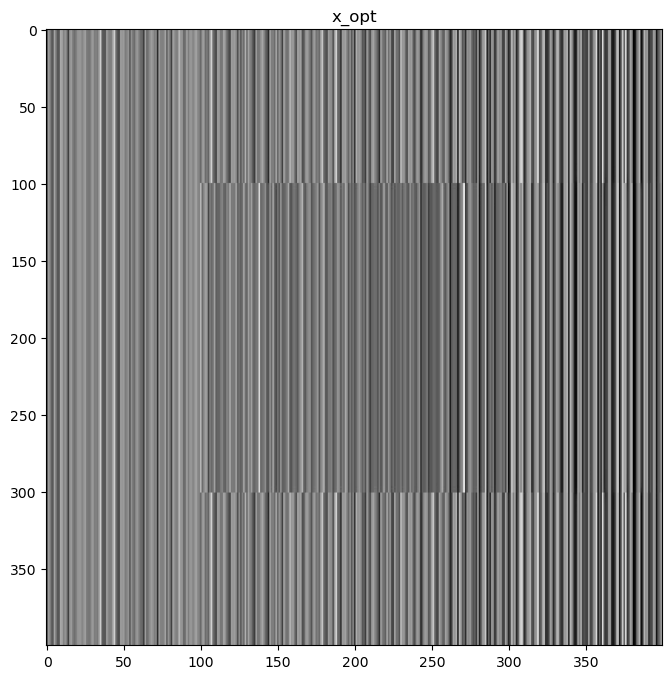

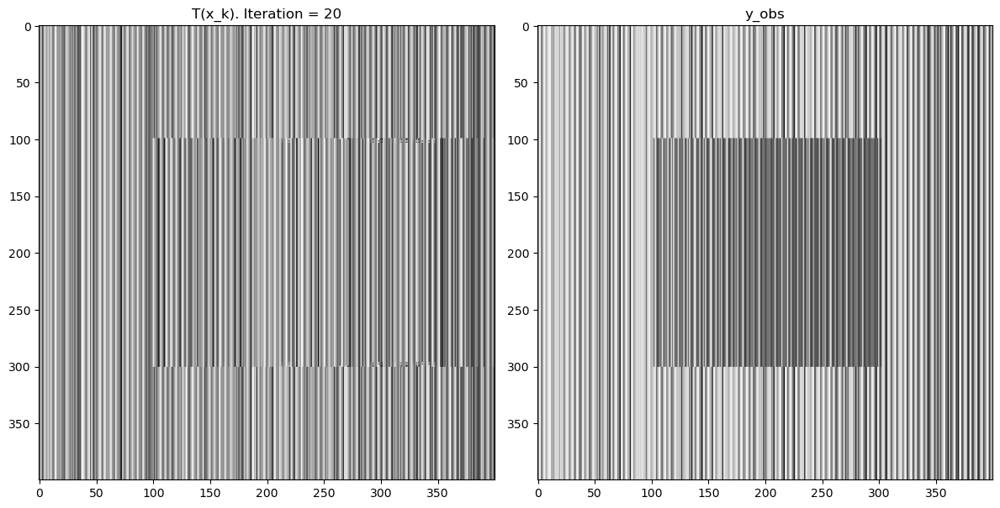

<Figure size 640x480 with 0 Axes>

objective function = 31357.16015625
diff_x_gt: 1.3459749221801758
diff_x: 185.70607625043752
-----------


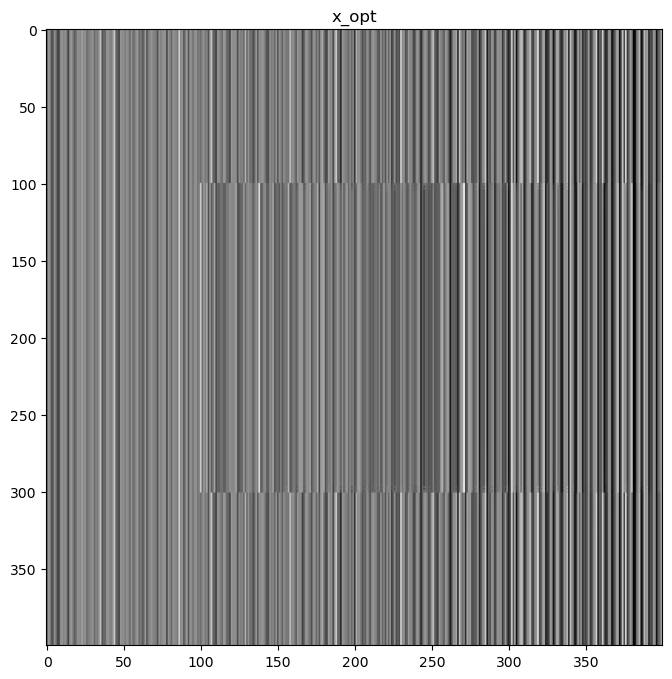

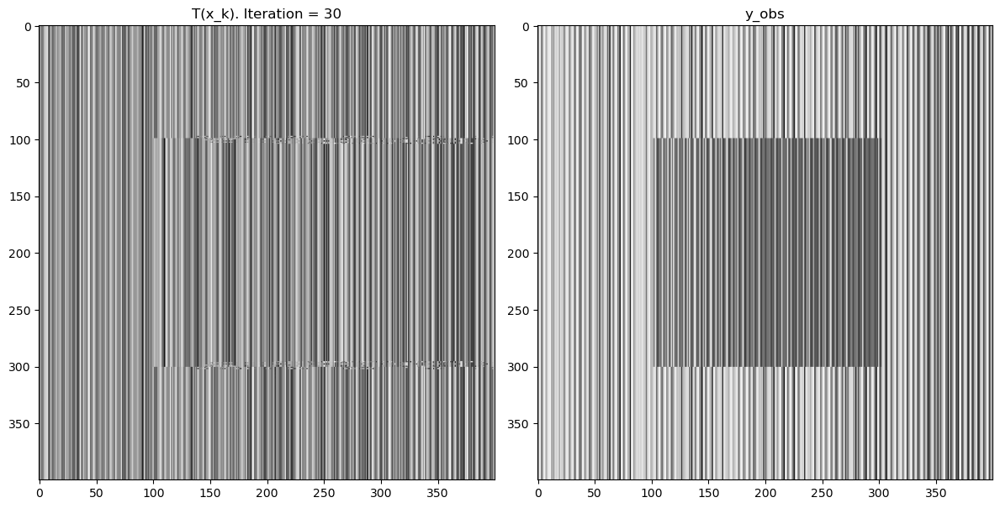

<Figure size 640x480 with 0 Axes>

objective function = 30123.423828125
diff_x_gt: 1.1060326099395752
diff_x: 185.3144819165938
-----------


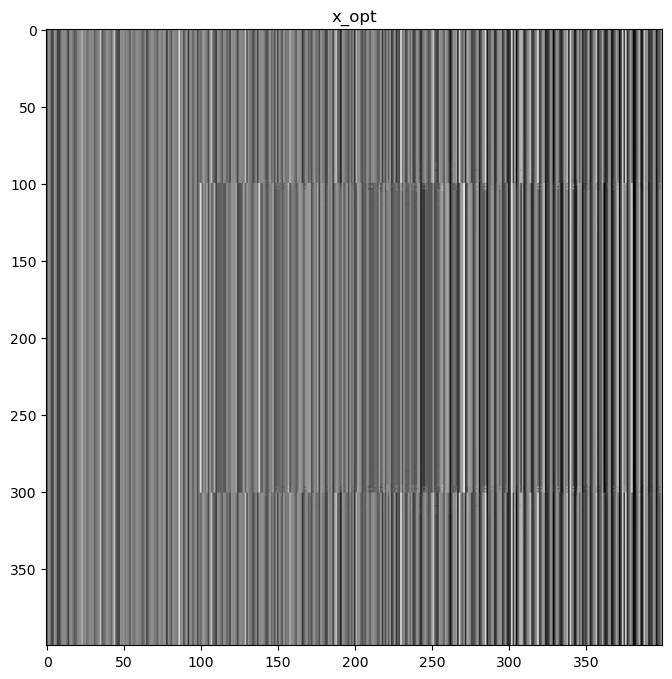

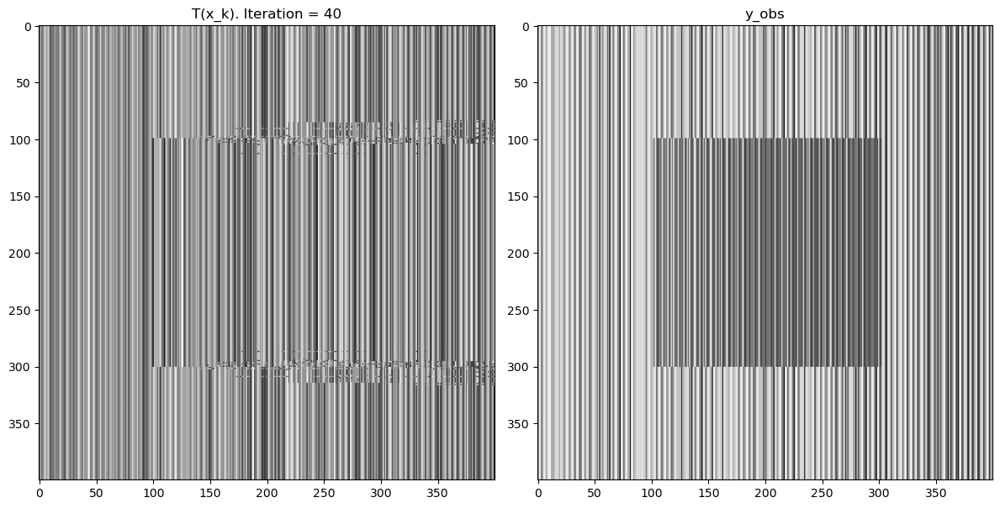

<Figure size 640x480 with 0 Axes>

objective function = 32731.2265625
diff_x_gt: 1.1899458169937134
diff_x: 185.145741546794
-----------


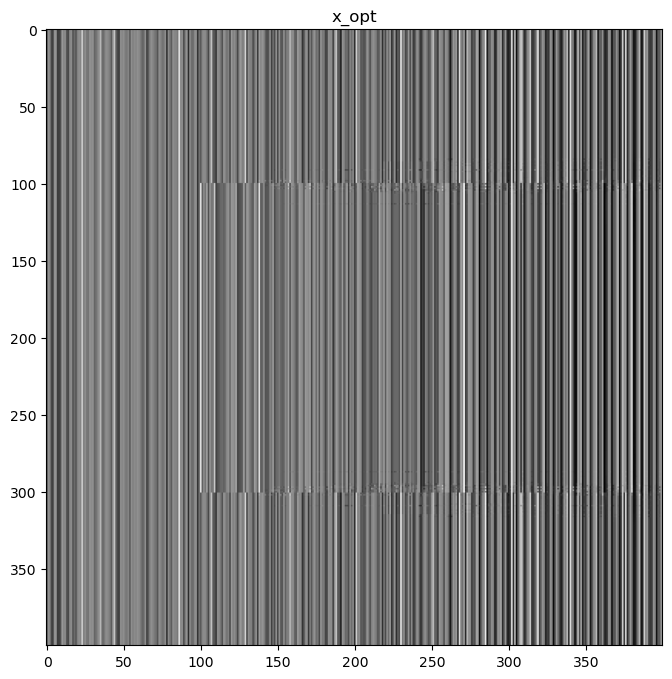

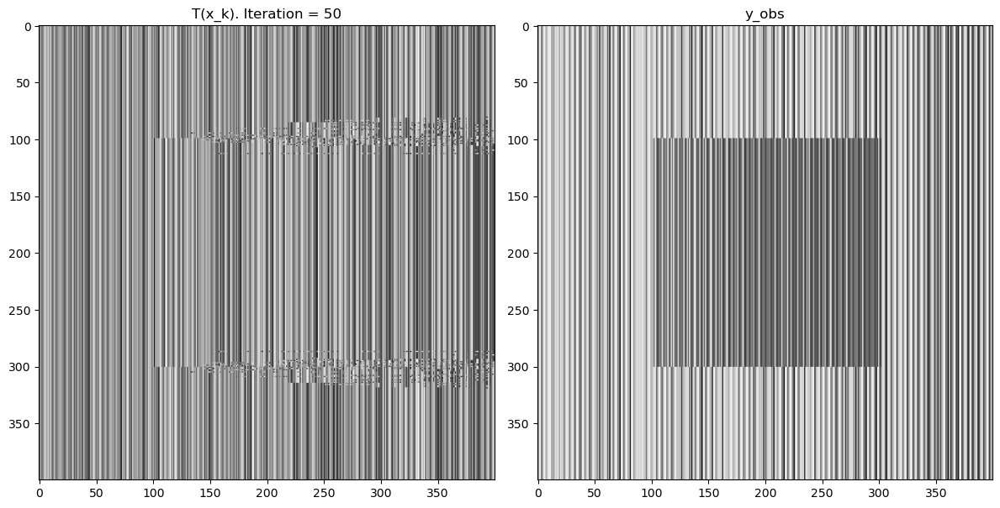

<Figure size 640x480 with 0 Axes>

objective function = 31911.52734375
diff_x_gt: 1.0260790586471558
diff_x: 185.41962427900728
-----------


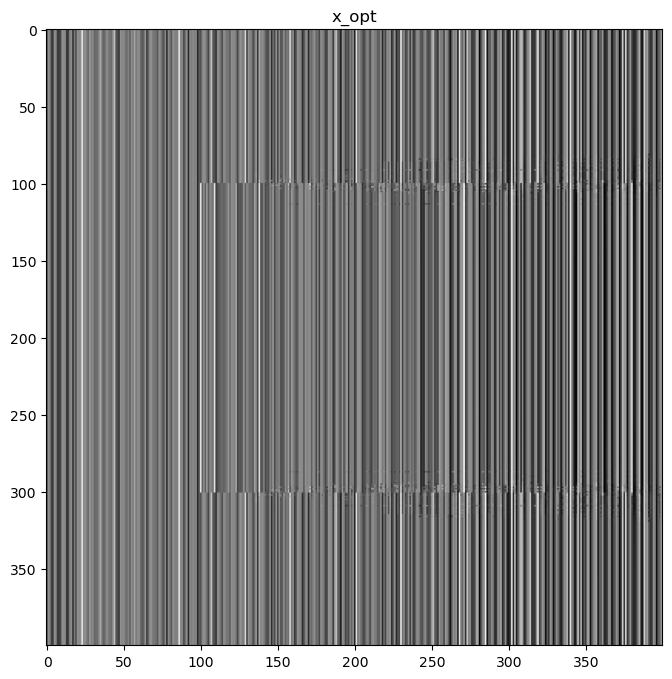

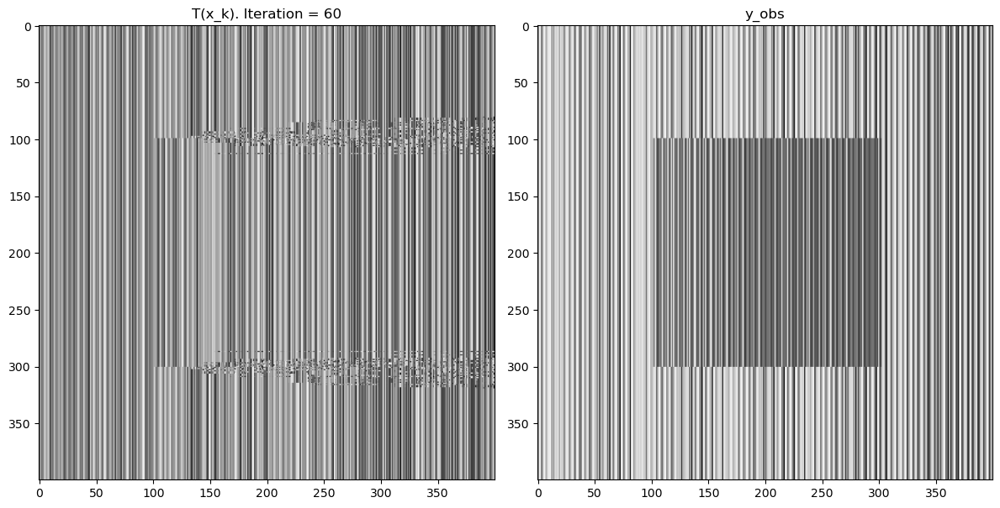

<Figure size 640x480 with 0 Axes>

objective function = 30955.51171875
diff_x_gt: 1.0662355422973633
diff_x: 185.5643290546533
-----------


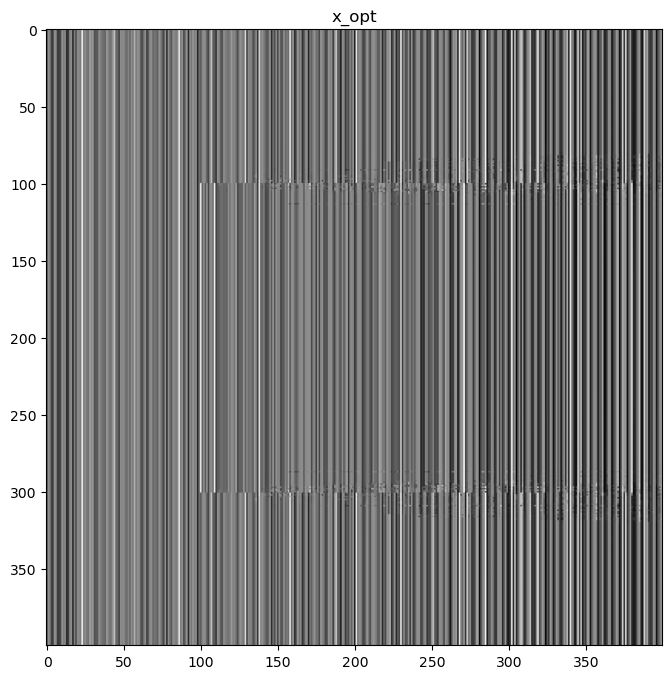

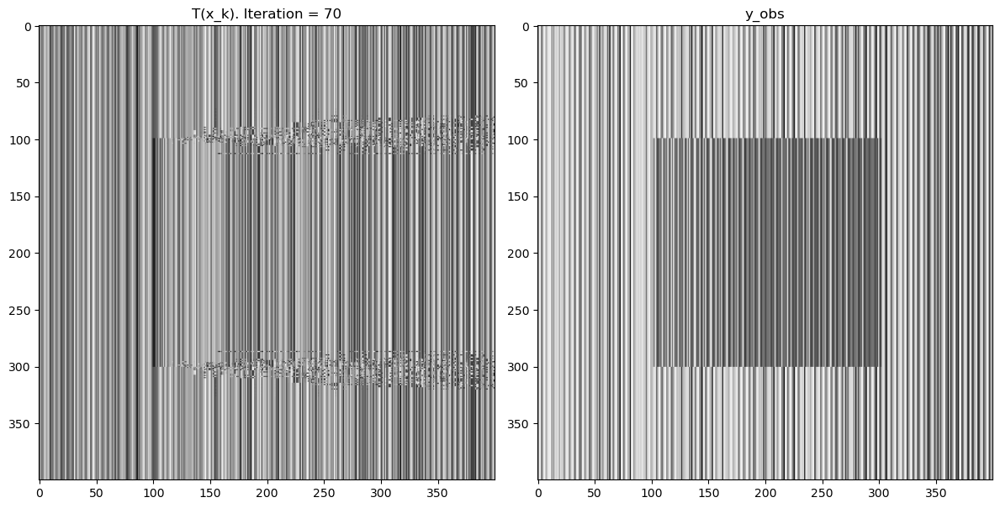

<Figure size 640x480 with 0 Axes>

objective function = 30405.791015625
diff_x_gt: 0.9810786247253418
diff_x: 185.3686375730699
-----------


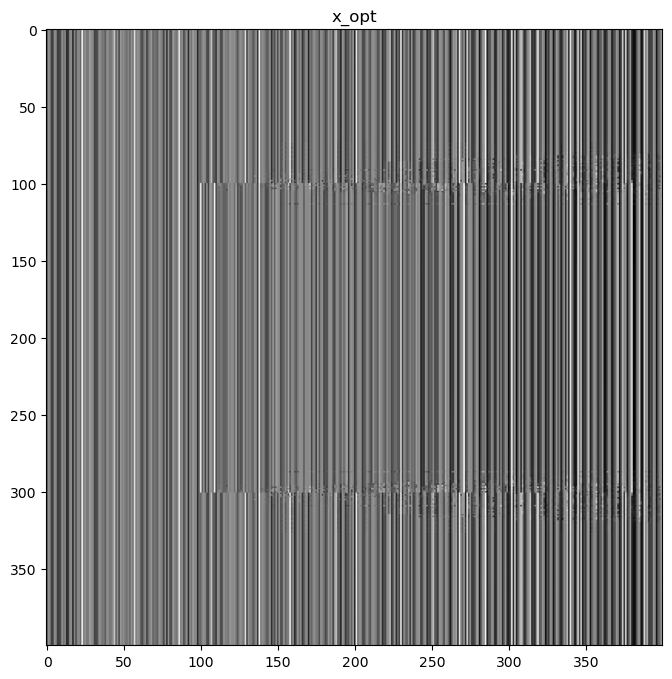

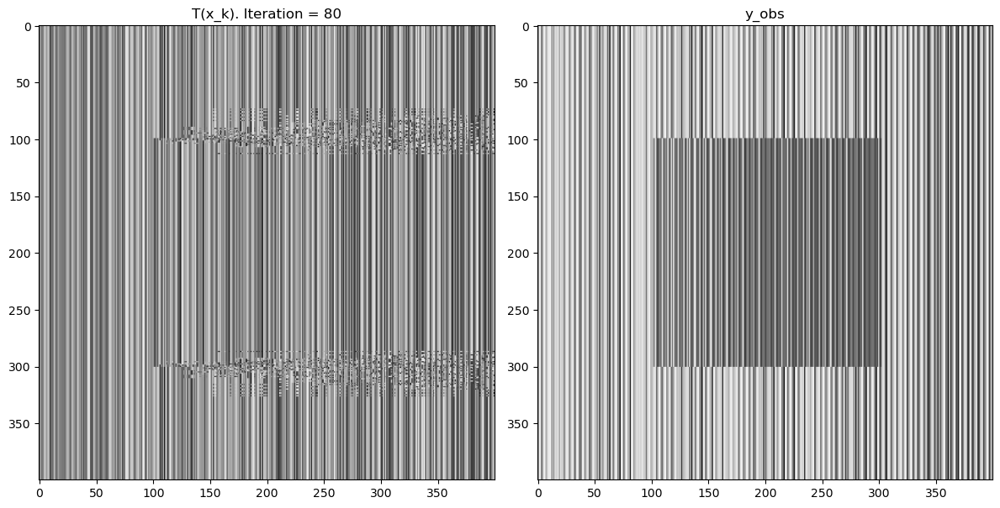

<Figure size 640x480 with 0 Axes>

objective function = 30195.26953125
diff_x_gt: 0.9639245271682739
diff_x: 185.068510564743
-----------


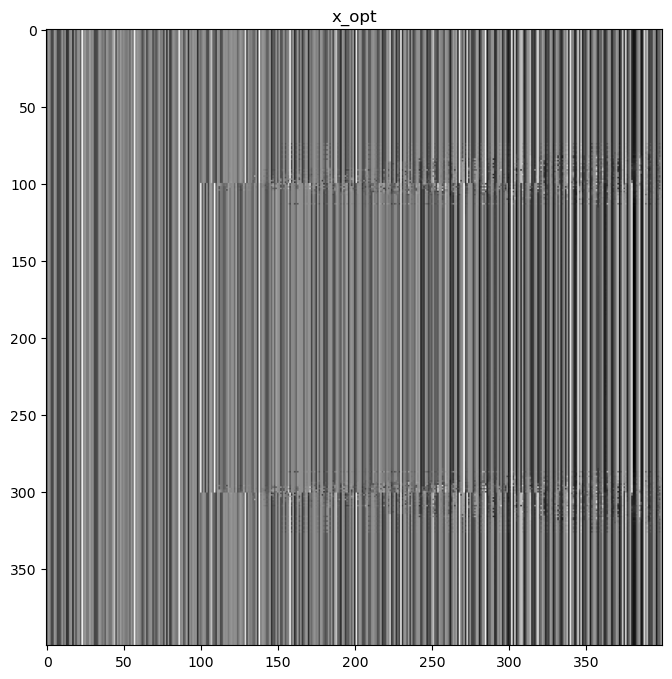

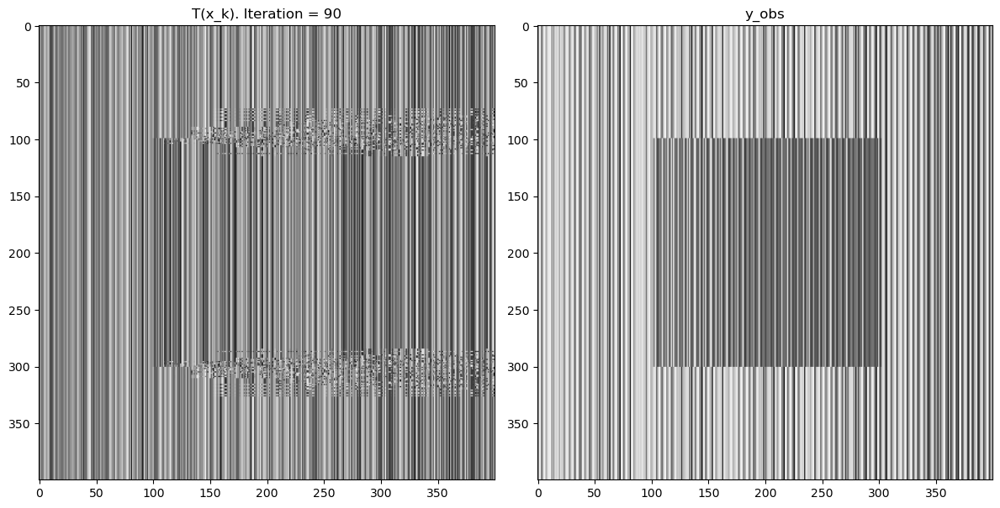

<Figure size 640x480 with 0 Axes>

objective function = 31174.625
diff_x_gt: 0.9268410205841064
diff_x: 184.6956682084556
-----------


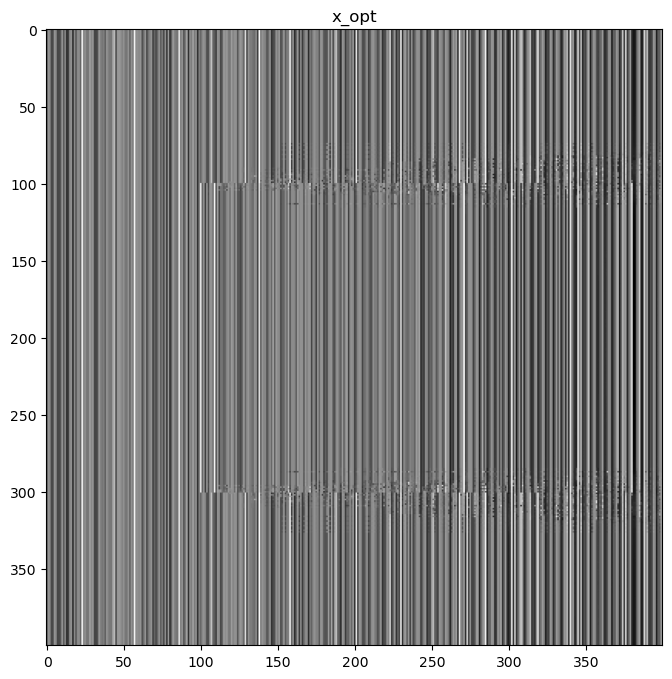

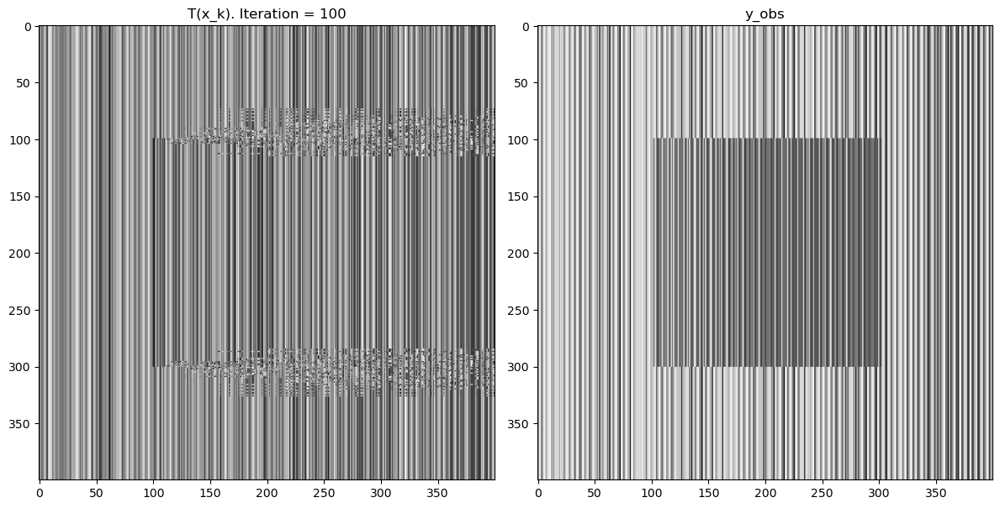

<Figure size 640x480 with 0 Axes>

In [16]:
#optimization with total variation regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "white_square.png"), as_gray=True), requires_grad= True)
y = forward(x_gt)
x_0 = y.abs()

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 100, eps = 1e-4, lr = 0.01, reg = 'tv', lam = 1e-9, k_print = 10 )

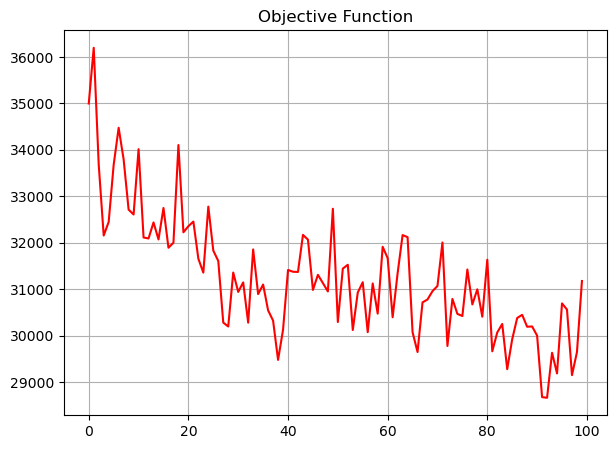

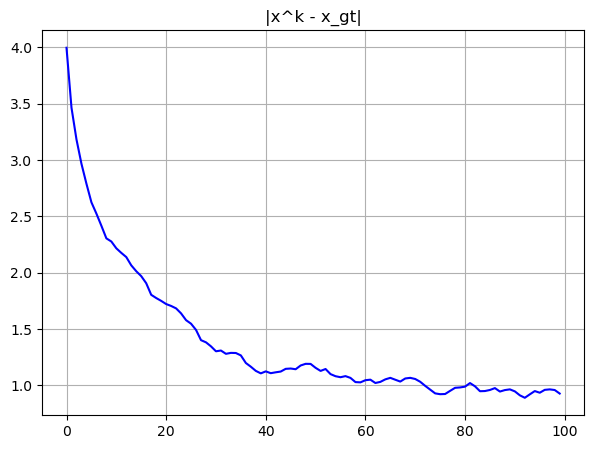

tensor(3.9971)


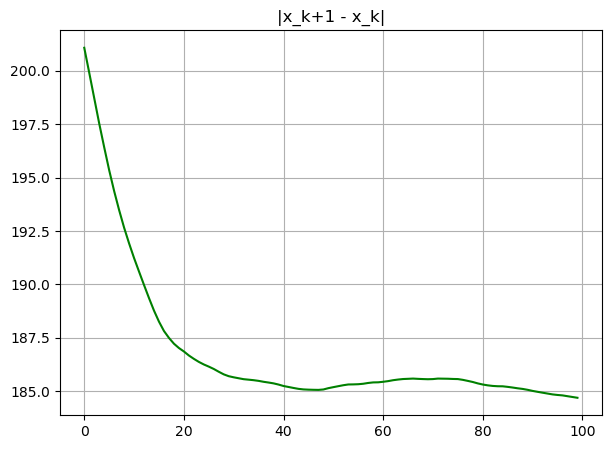

In [17]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

### optimization with l2 regularization

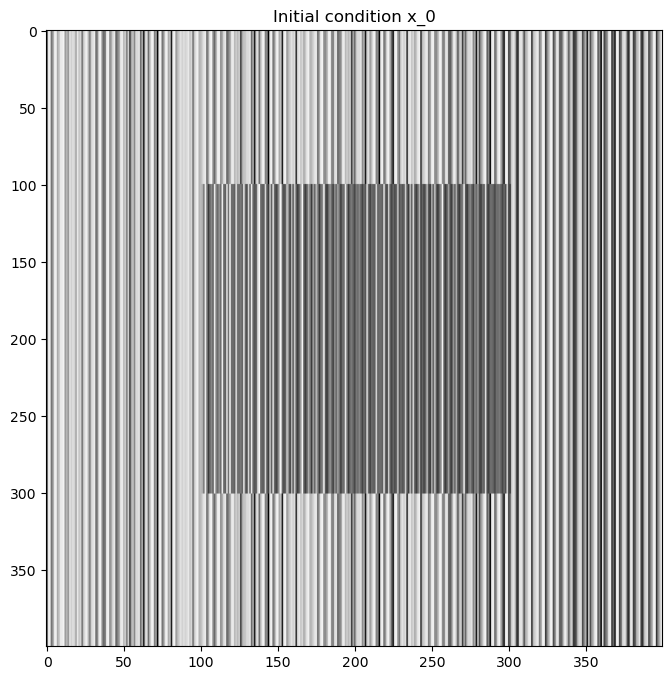

objective function = 30270.546875
diff_x_gt: 0.819822371006012
diff_x: 186.18455211862897
-----------


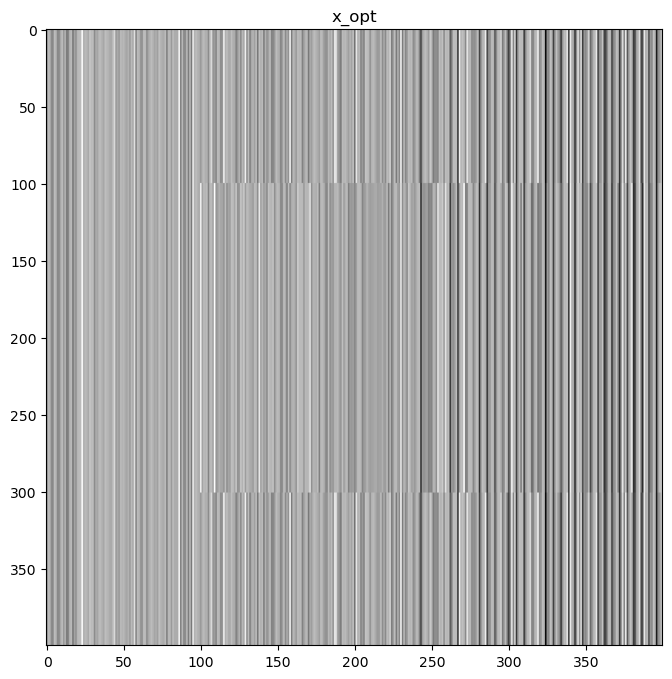

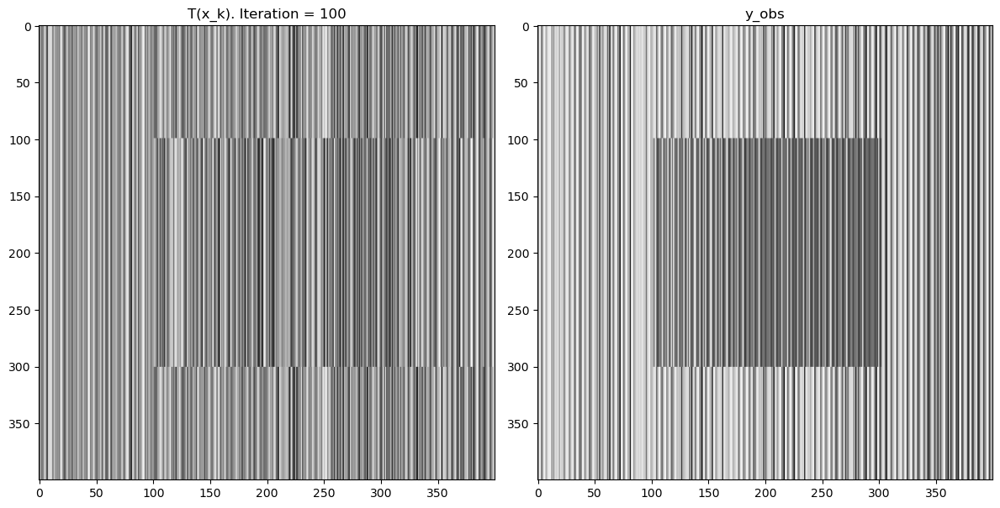

<Figure size 640x480 with 0 Axes>

objective function = 32659.25
diff_x_gt: 0.8737909197807312
diff_x: 185.28015888446632
-----------


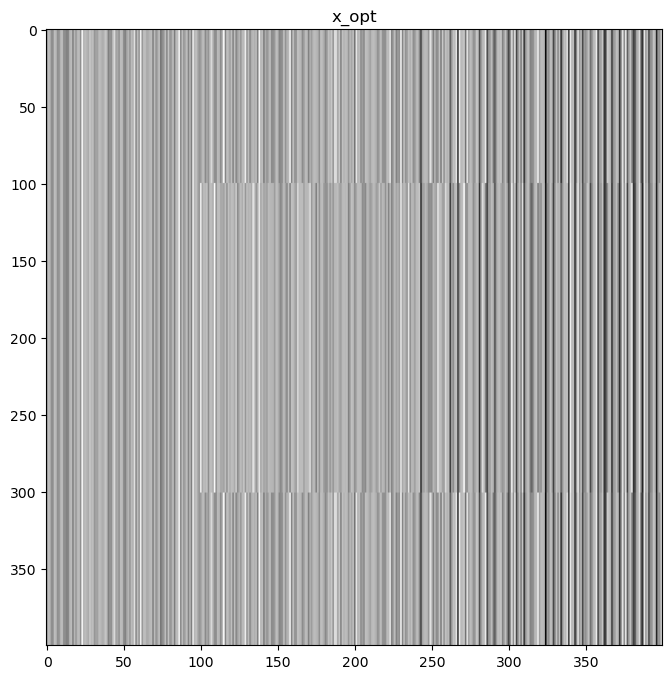

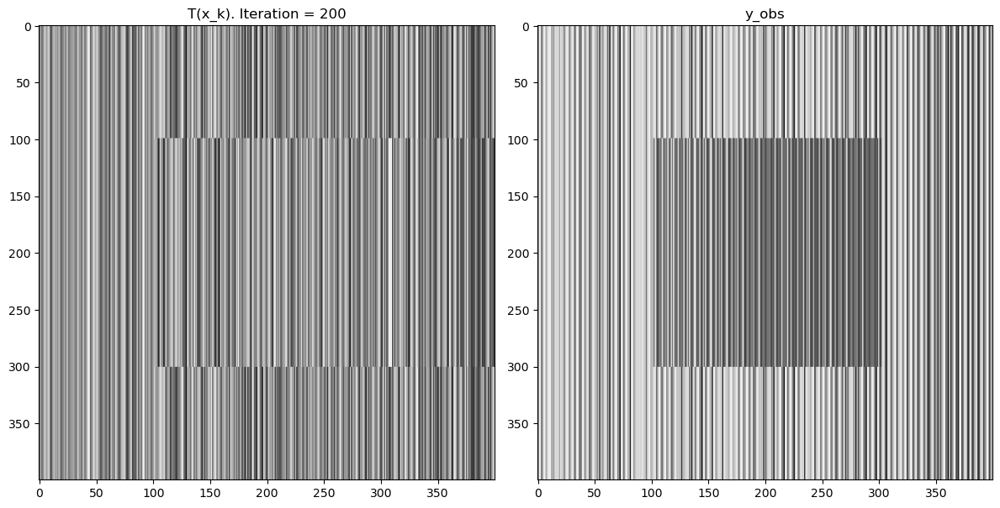

<Figure size 640x480 with 0 Axes>

In [18]:
#optimization with l2 regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "white_square.png"), as_gray=True), requires_grad= True)
y = forward(x_gt)
x_0 = y.abs()

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 200, eps = 1e-4, lr = 0.01, reg = 'l2', lam = 1e-9, k_print = 100 )

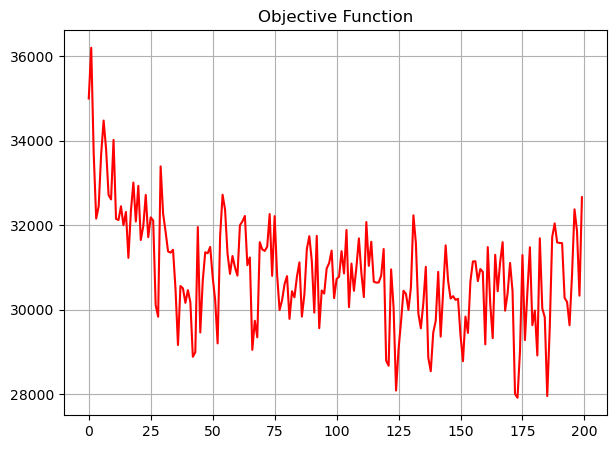

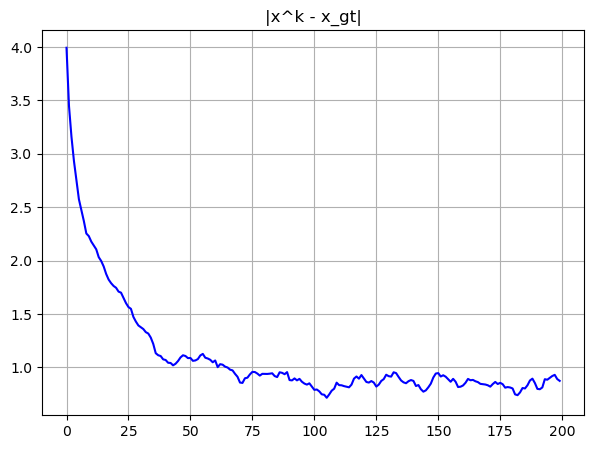

tensor(3.9923)


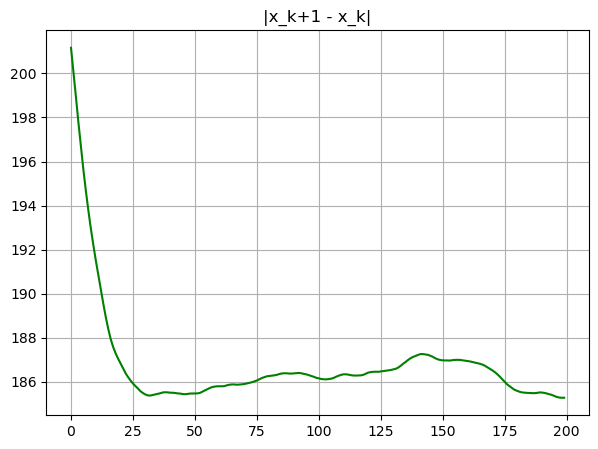

In [19]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

## image: VAMOO

### sanity check

tensor(255., dtype=torch.float64, grad_fn=<MaxBackward1>)
tensor(0., dtype=torch.float64, grad_fn=<MinBackward1>)


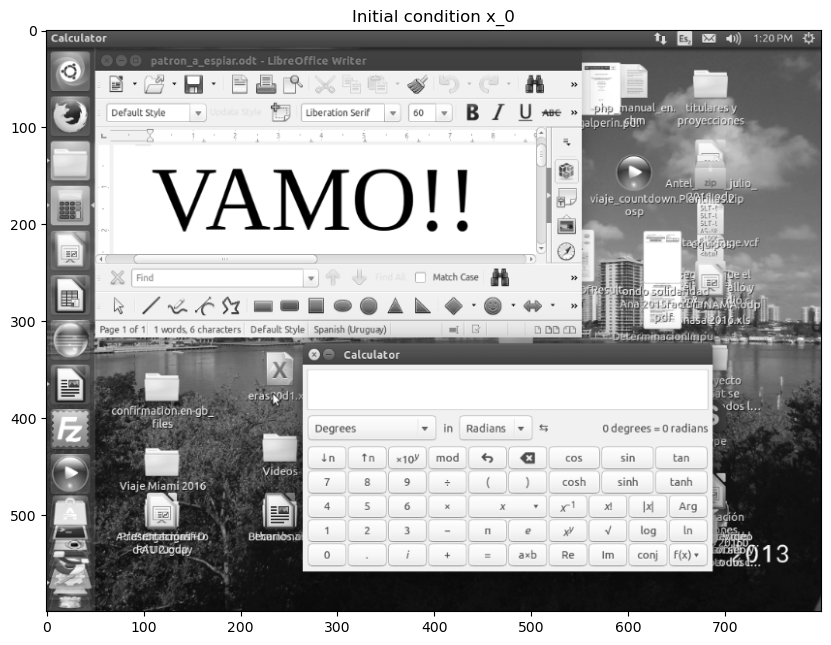

objective function = 0.0
diff_x_gt: 0.0
diff_x: 0.0
-----------


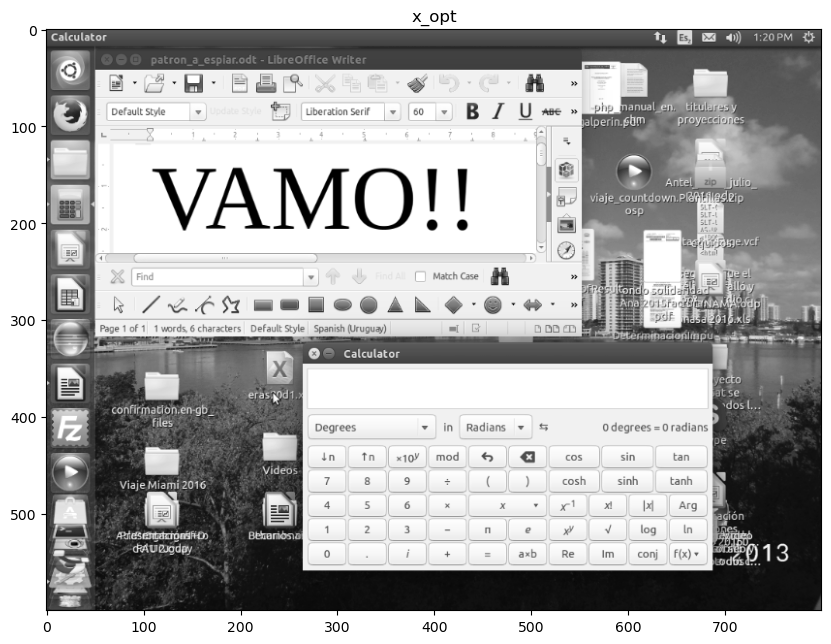

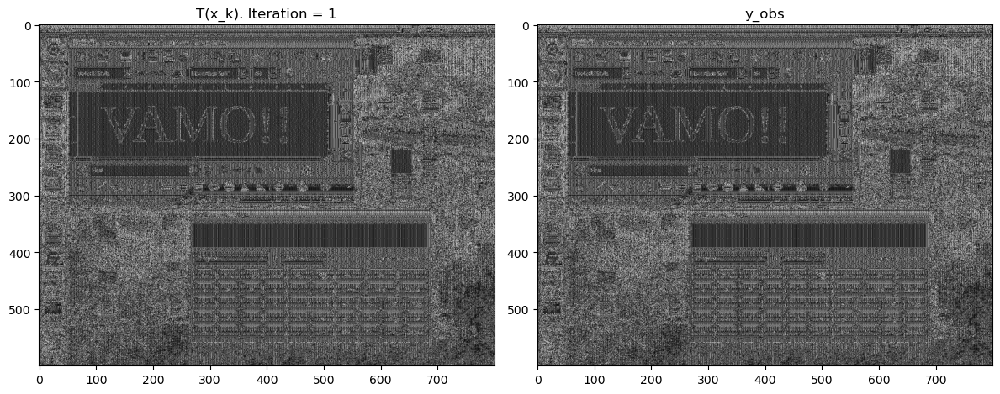

<Figure size 640x480 with 0 Axes>

tensor(255., dtype=torch.float64, grad_fn=<MaxBackward1>)
tensor(0., dtype=torch.float64, grad_fn=<MinBackward1>)


In [17]:
#initial condition x_0 = x_gt (ground truth)

image_path = "./imagenes/VAMO.png"
img = np.asarray(Image.open(image_path))[:,:,0] #solo canal rojo
x_gt = torch.tensor(img, dtype=torch.float64, requires_grad=True)
#imagen = forward(img_slice)


#x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
#x_gt = 255 * x_gt
x_0 = x_gt
print(x_0.max())
print(x_0.min())
x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 200, eps = 1e-4, lr = 0.01, reg = None, lam = 1e-9, k_print = 1)
print(x_opt_final.max())
print(x_opt_final.min())

In [22]:
print('Objective Function = {}'.format(OF_record[0]))
print('|x^k - x_gt| = {}'.format(diff_x_gt_record[0]))
print('|x_k+1 - x_k| = {}'.format(diff_x_record[0]))

Objective Function = 0.0
|x^k - x_gt| = 0.0
|x_k+1 - x_k| = 0.0


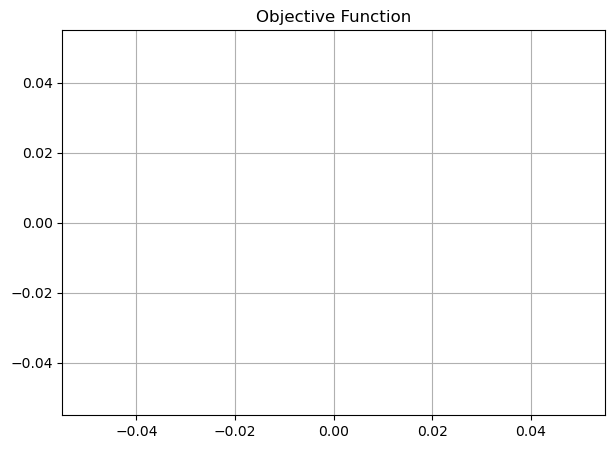

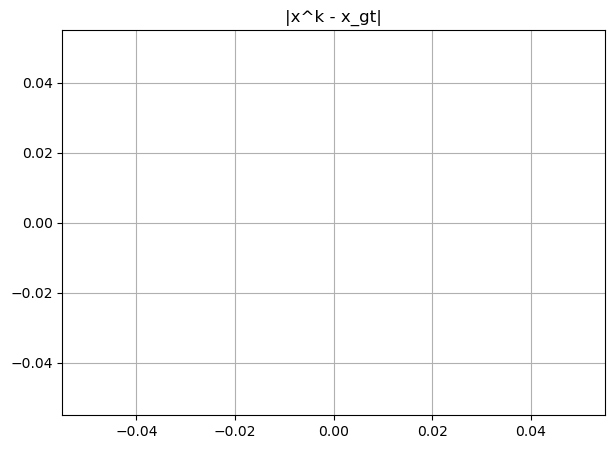

tensor(0., dtype=torch.float64)


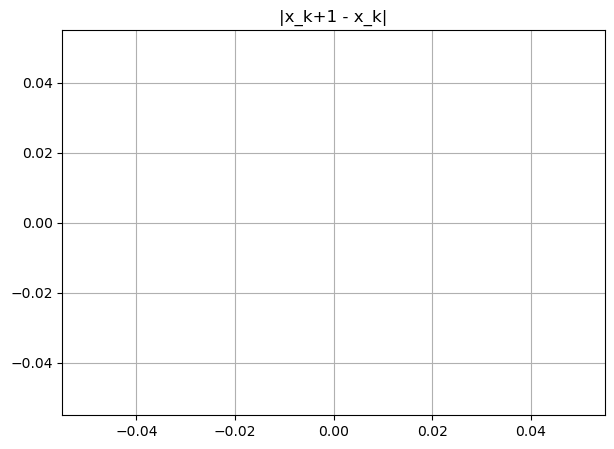

In [10]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

### optimization with no regularization

#### initial condition x_0: magnitude of VAMOO

Dynamic Range of x_gt = [0.0,255.0]
Dynamic Range of x_0 = [0.00021723032114095986,0.4493834674358368]


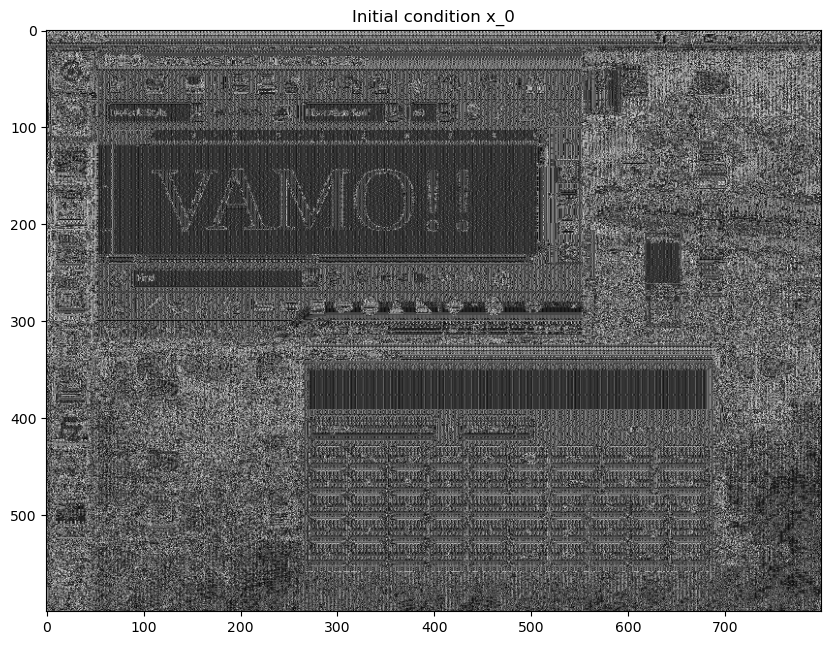

Dynamic Range of x_opt on k = 0. = [0.00021723032114095986,0.4493834674358368]
Dynamic Range of x_opt on k = 1. = [-0.009240123443305492,0.4585559368133545]
objective function = 20456.703125
diff_x_gt: 6.186572551727295
diff_x: 126207.04334395556
-----------


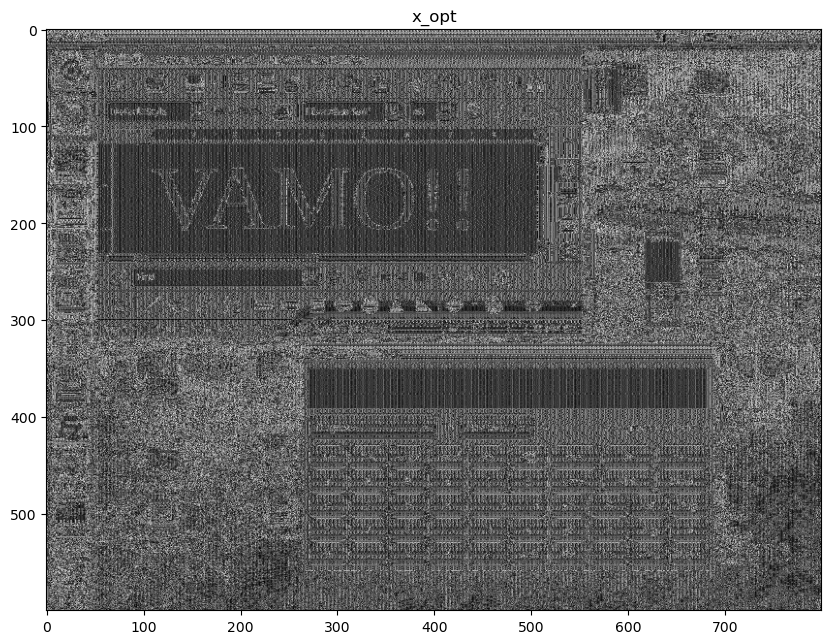

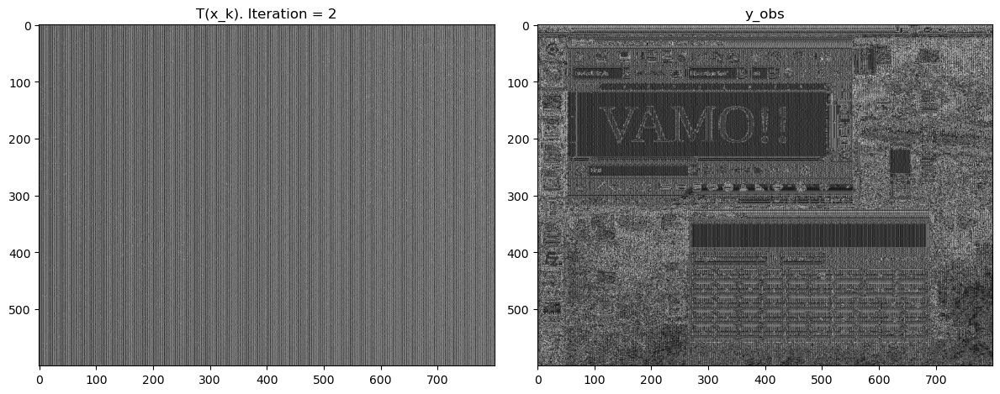

<Figure size 640x480 with 0 Axes>

Dynamic Range of x_opt on k = 2. = [-0.01882353611290455,0.468533456325531]
Dynamic Range of x_opt on k = 3. = [-0.028288178145885468,0.47662830352783203]
objective function = 20390.490234375
diff_x_gt: 5.442050457000732
diff_x: 126207.11745054569
-----------


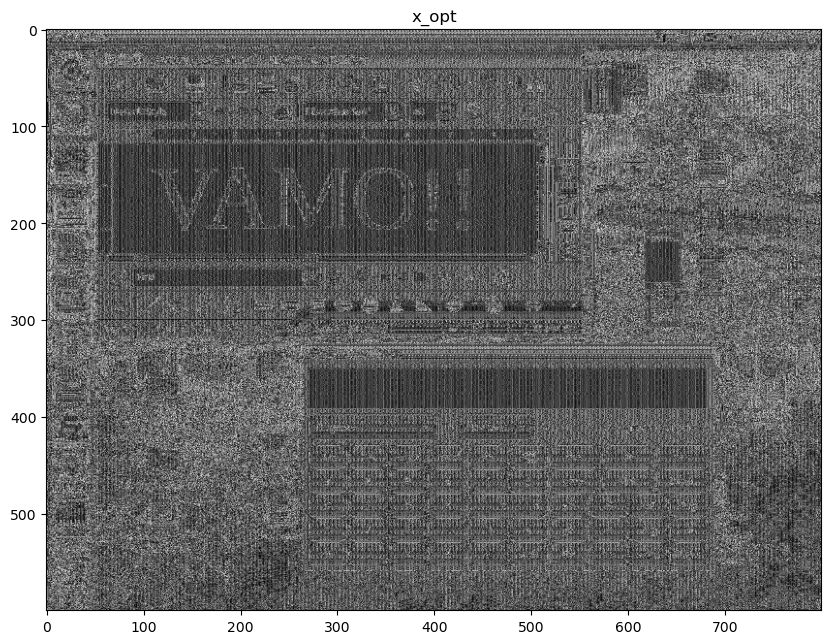

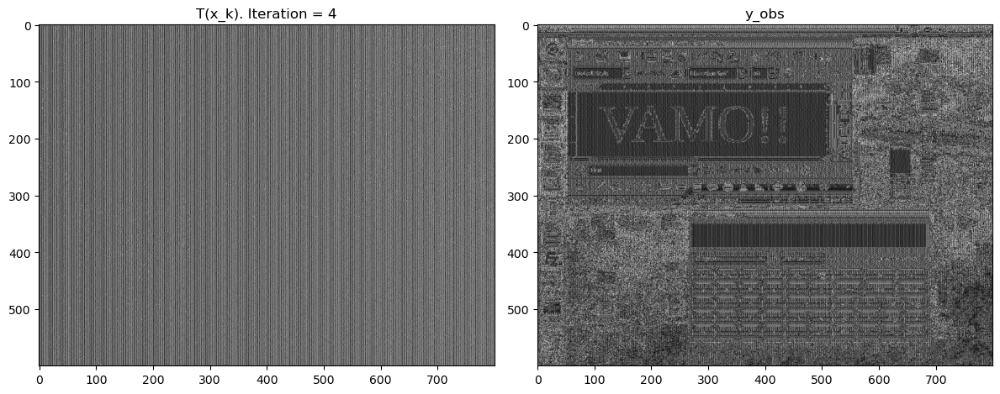

<Figure size 640x480 with 0 Axes>

Dynamic Range of x_opt on k = 4. = [-0.03760378062725067,0.48418745398521423]
Dynamic Range of x_opt_final = [-0.046919140964746475,0.4926363527774811]


In [20]:
#optimization with no regularization

image_path = "./imagenes/VAMO.png"
img = np.asarray(Image.open(image_path))[:,:,0] #solo canal rojo
x_gt = torch.tensor(img, dtype=torch.float64, requires_grad=True)
print('Dynamic Range of x_gt = [{},{}]'.format(x_gt.min(), x_gt.max()))
y = forward(x_gt)
x_0 = y.abs()
print('Dynamic Range of x_0 = [{},{}]'.format(x_0.min(), x_0.max()))

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 5, eps = 1e-4, lr = 0.01, reg = None, lam = 0, k_print = 2)

print('Dynamic Range of x_opt_final = [{},{}]'.format(x_opt_final.min(), x_opt_final.max()))

In [ ]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

#### initial condition x_0: VAMOO blurred

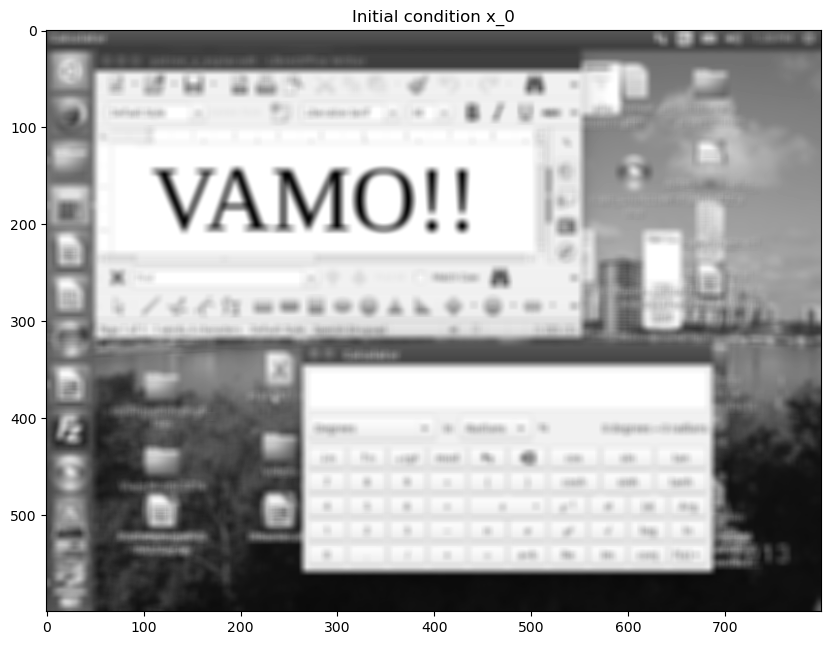

objective function = 7975.392578125
diff_x_gt: 1.911674142375735
diff_x: 181.7426041134999
-----------


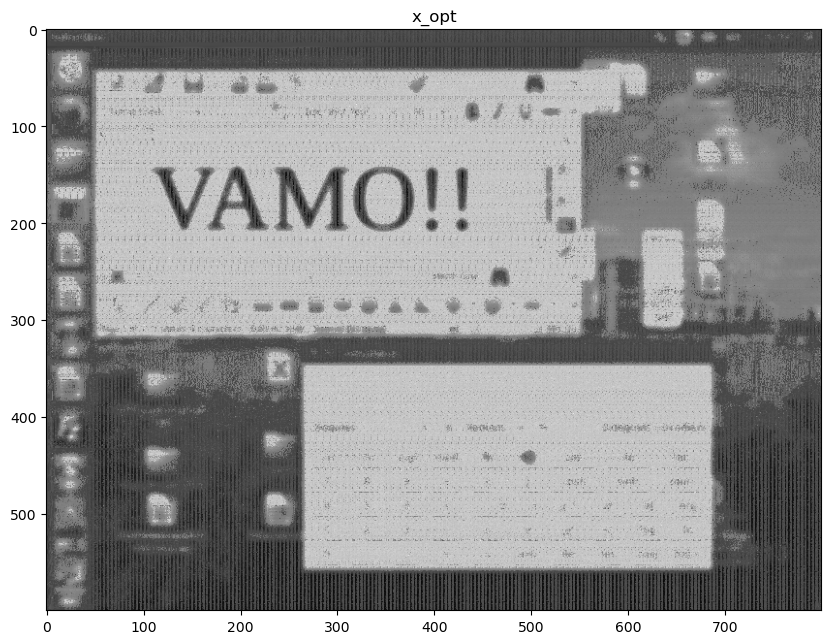

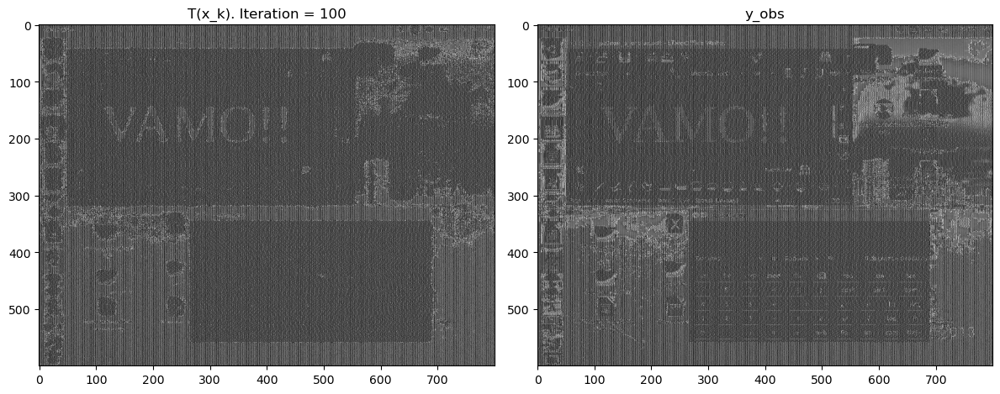

<Figure size 640x480 with 0 Axes>

objective function = 7808.05859375
diff_x_gt: 1.3277041050907665
diff_x: 187.05170962069215
-----------


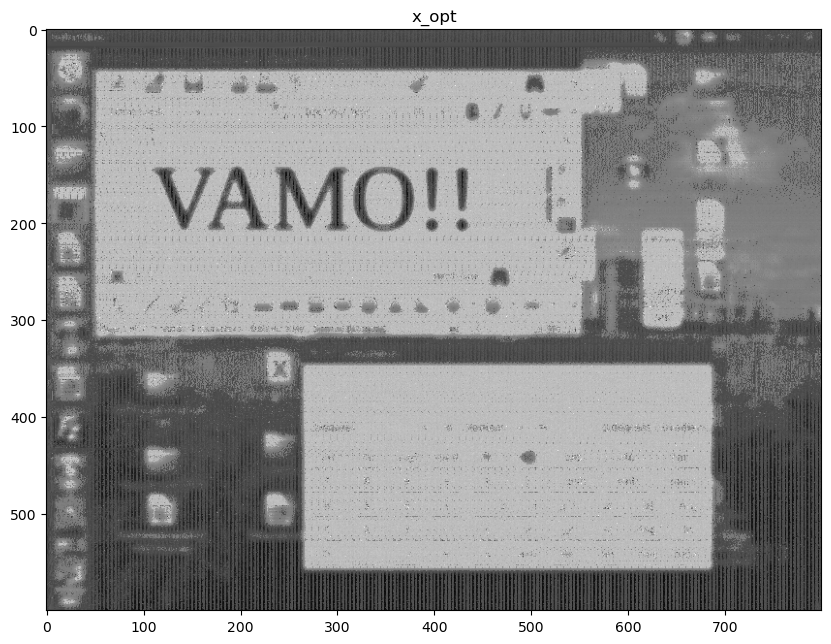

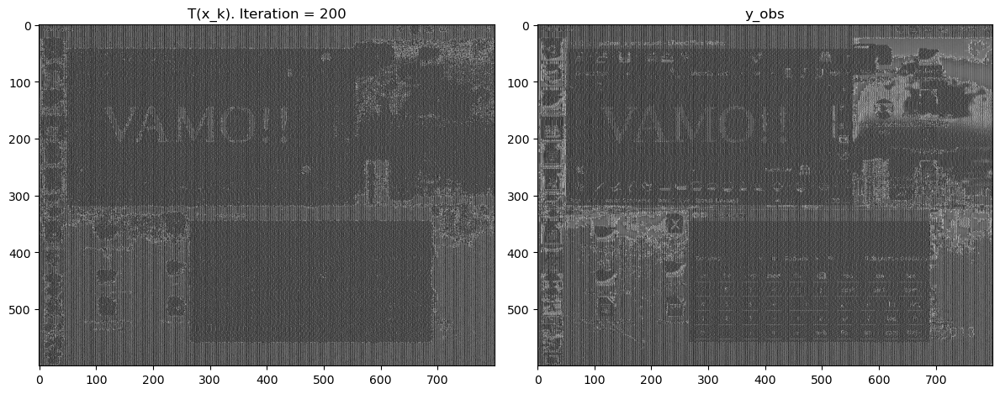

<Figure size 640x480 with 0 Axes>

objective function = 7913.7431640625
diff_x_gt: 1.1567547619716103
diff_x: 189.67888514197082
-----------


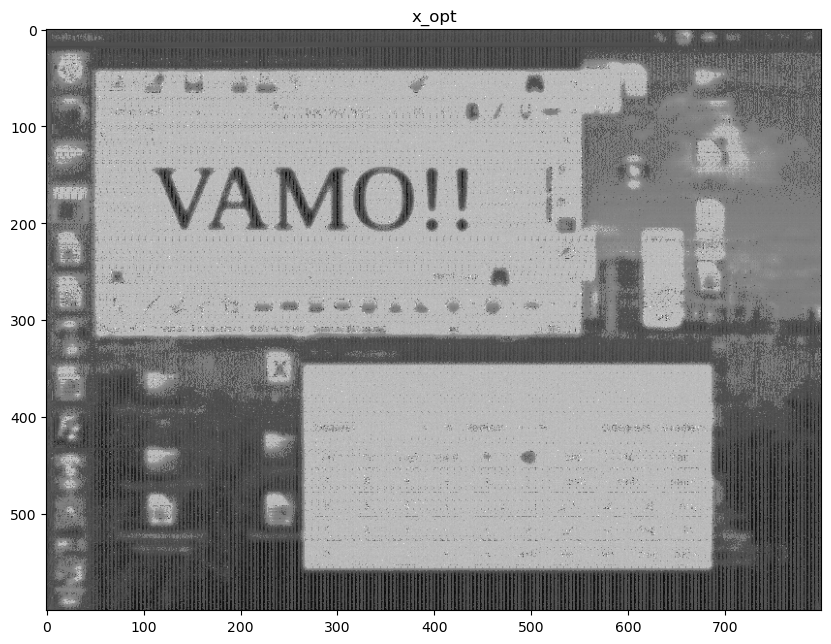

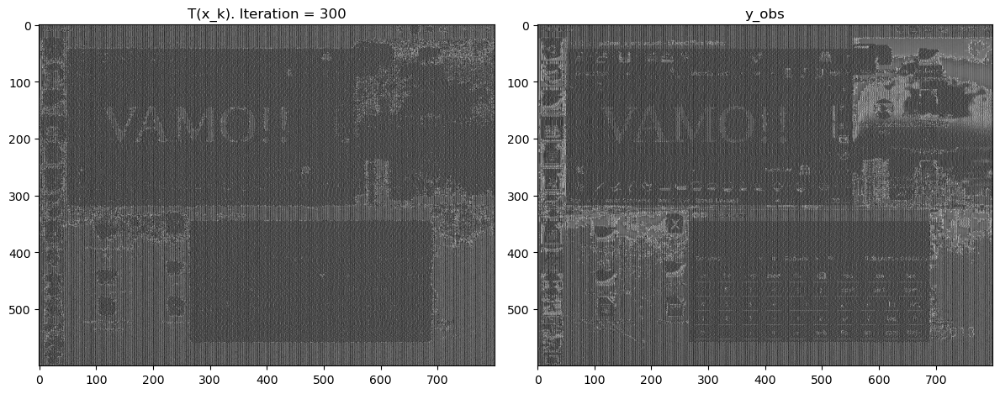

<Figure size 640x480 with 0 Axes>

objective function = 7847.54248046875
diff_x_gt: 1.062714215380286
diff_x: 191.5875059390492
-----------


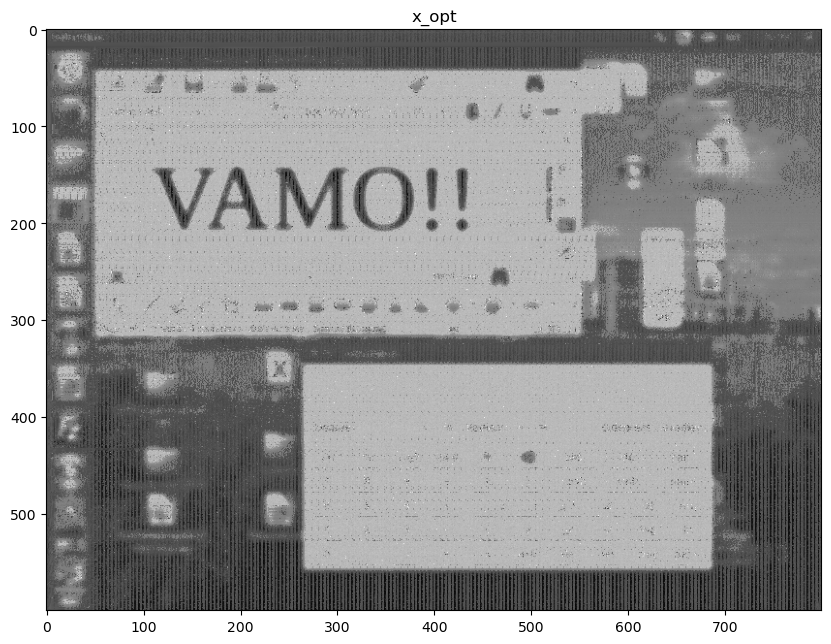

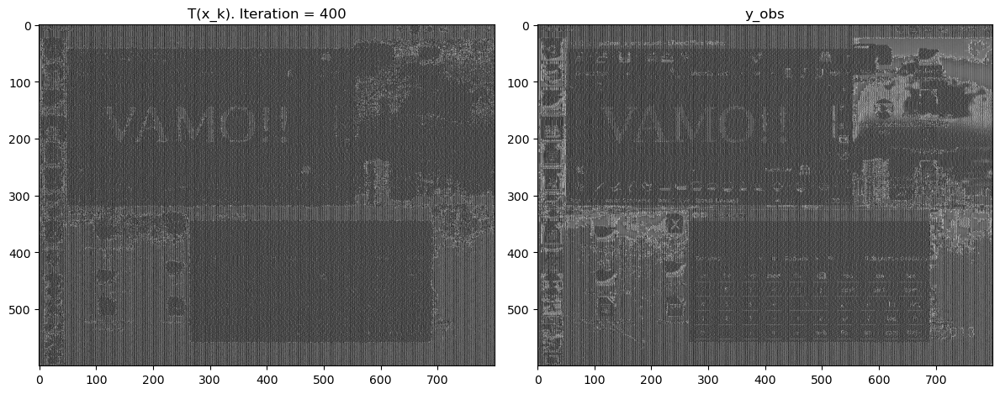

<Figure size 640x480 with 0 Axes>

objective function = 7893.271484375
diff_x_gt: 1.0064784502799586
diff_x: 193.22520297165573
-----------


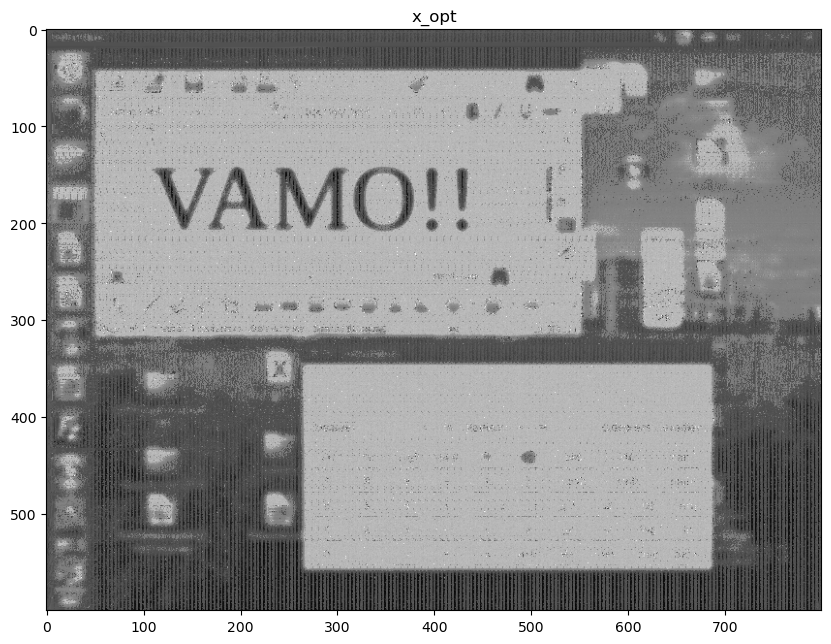

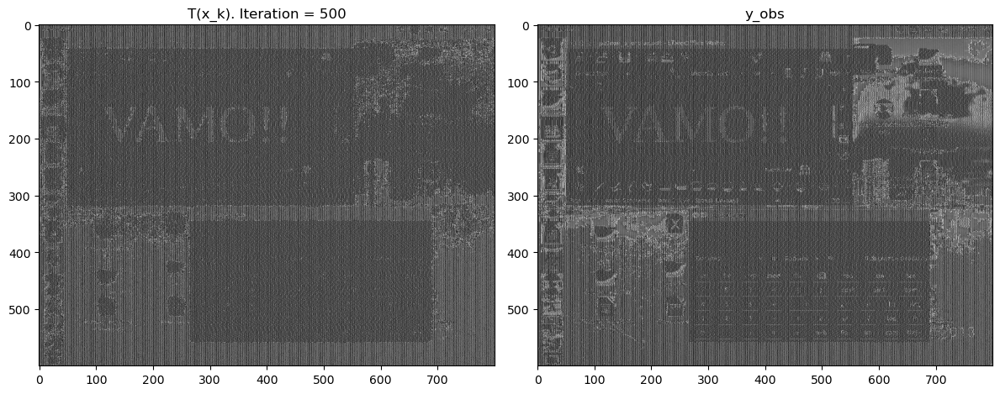

<Figure size 640x480 with 0 Axes>

objective function = 8006.8974609375
diff_x_gt: 0.9770394876288976
diff_x: 194.5340467940438
-----------


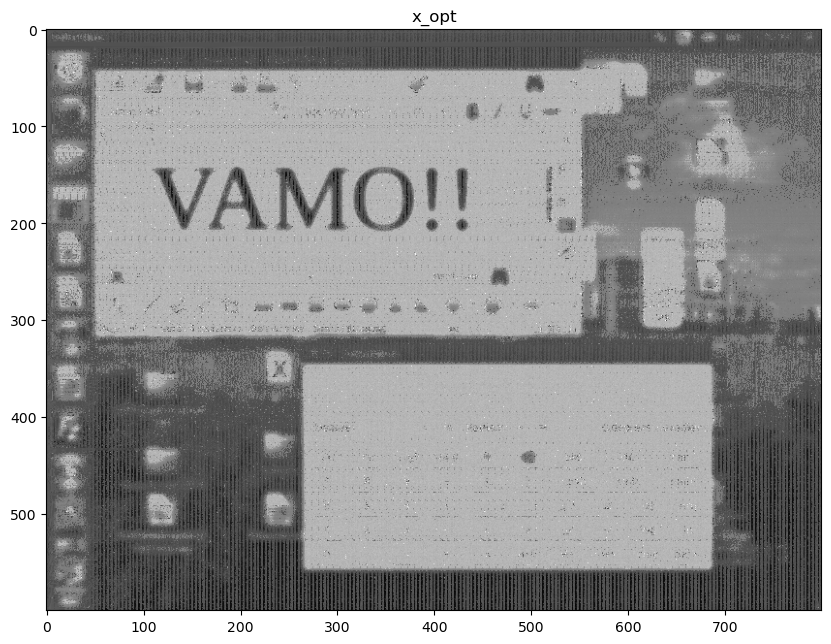

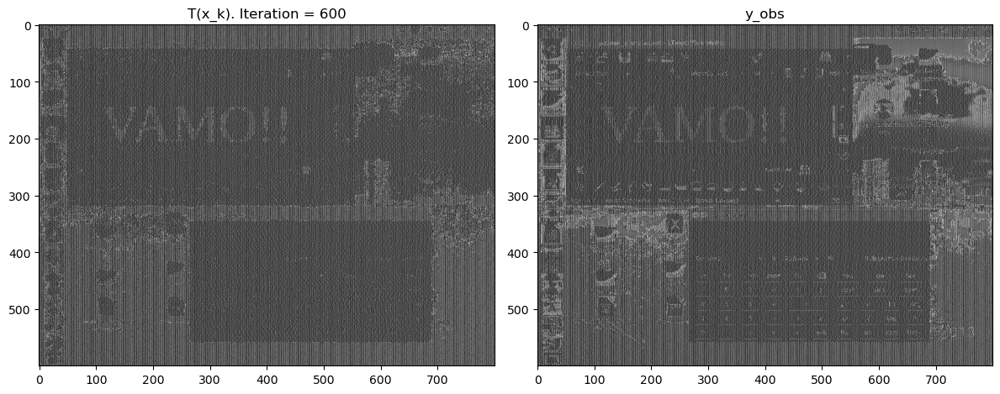

<Figure size 640x480 with 0 Axes>

objective function = 7973.79541015625
diff_x_gt: 0.9469676580106036
diff_x: 195.62482852838625
-----------


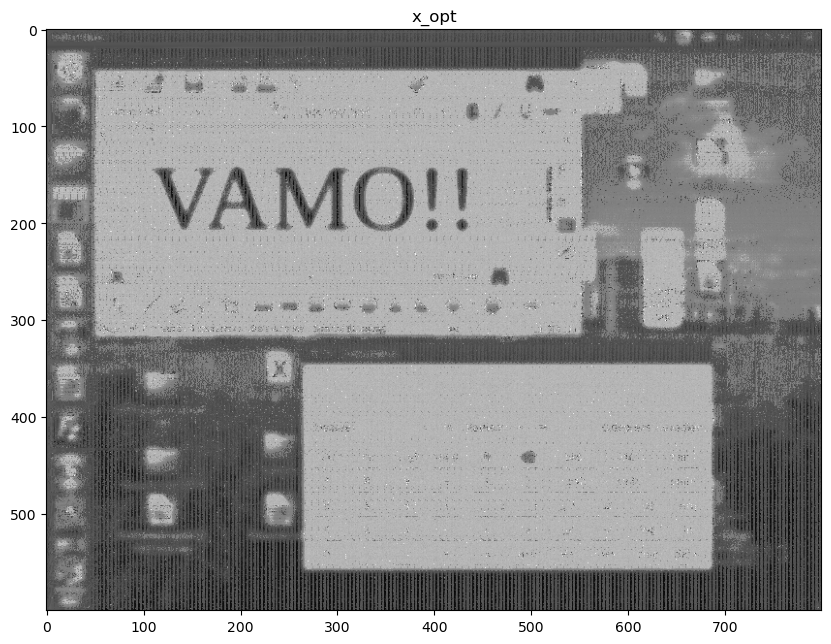

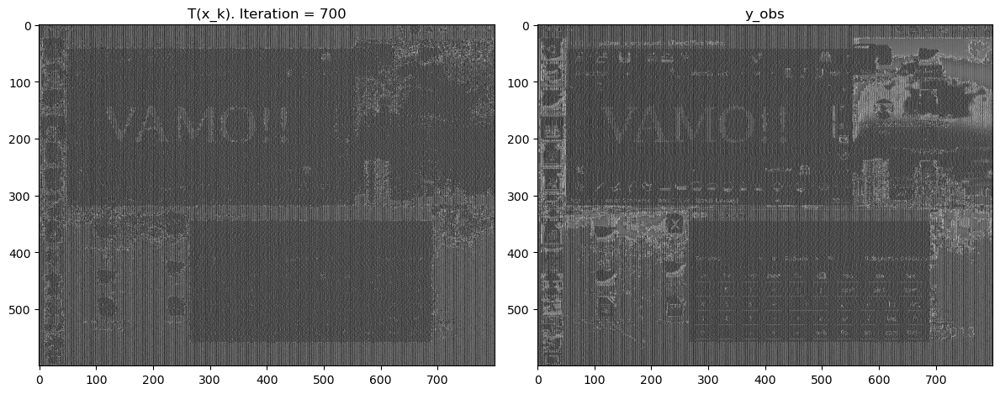

<Figure size 640x480 with 0 Axes>

objective function = 7845.28125
diff_x_gt: 0.9287821656453472
diff_x: 196.72286149282158
-----------


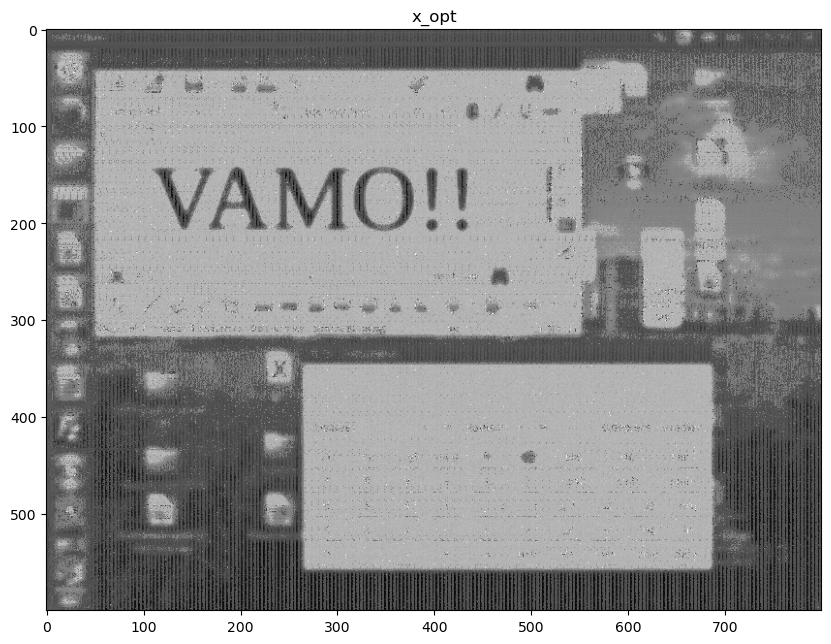

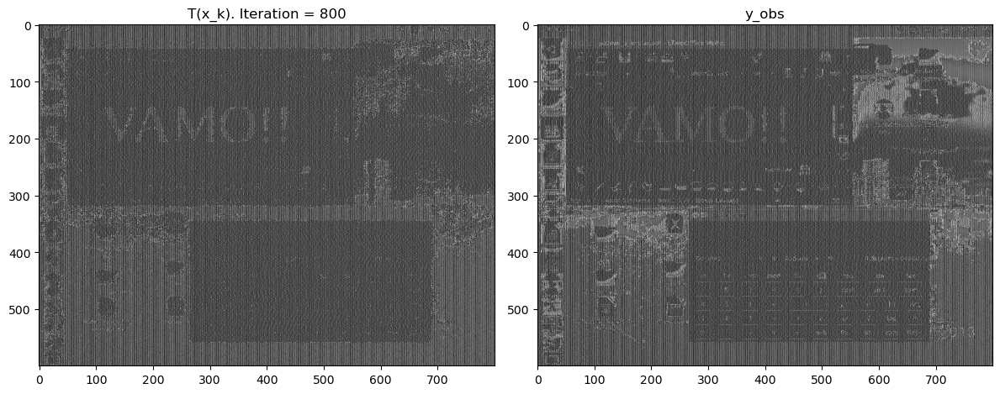

<Figure size 640x480 with 0 Axes>

objective function = 7846.87646484375
diff_x_gt: 0.8776915367981429
diff_x: 197.8165404747857
-----------


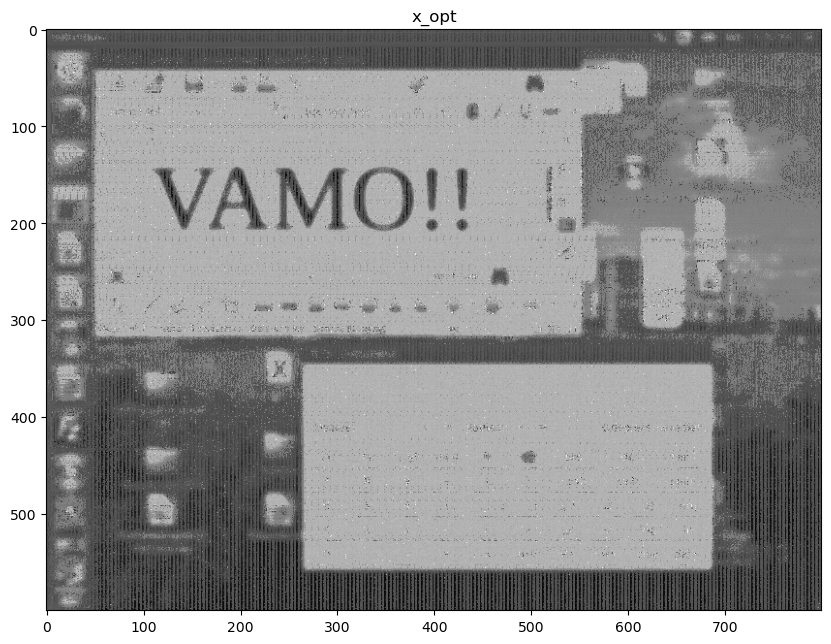

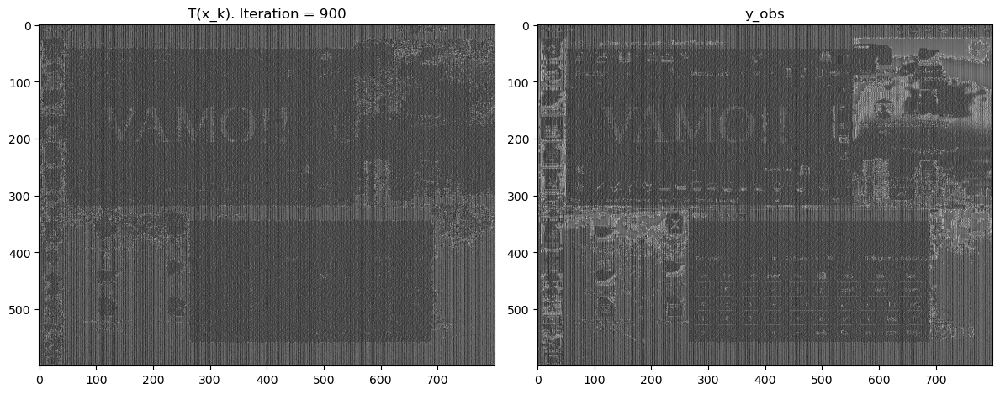

<Figure size 640x480 with 0 Axes>

objective function = 7984.08203125
diff_x_gt: 0.8816577674823511
diff_x: 198.90100410301105
-----------


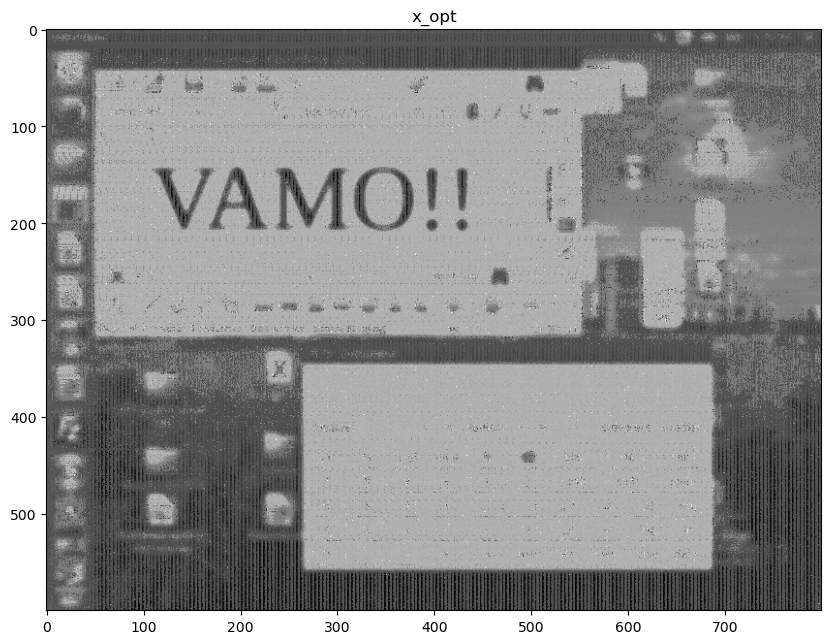

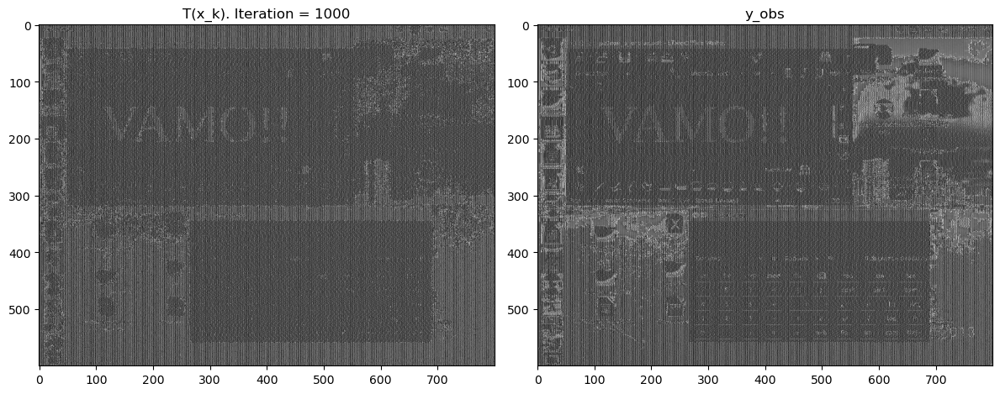

<Figure size 640x480 with 0 Axes>

In [5]:
#optimization with no regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
x_gt = x_gt.unsqueeze(0)
x_0 = gaussian_blur(x_gt, kernel_size = (9,9), sigma = 5.0)
x_gt = x_gt.squeeze(0)
x_0 = x_0.squeeze(0)
#x_0 = torch.zeros_like(x_gt)

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 1000, eps = 1e-4, lr = 0.01,, reg = None, lam = 0, k_print = 100 )

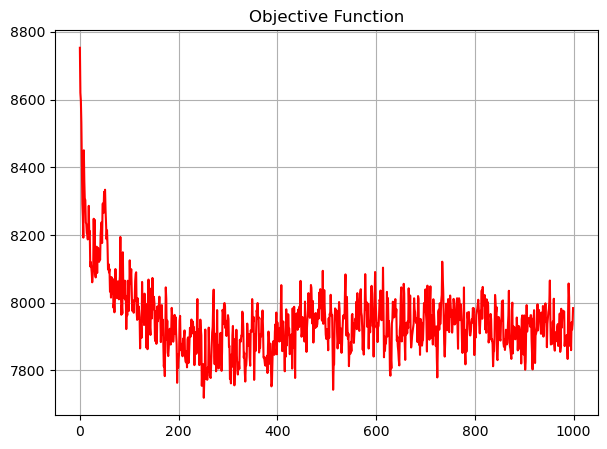

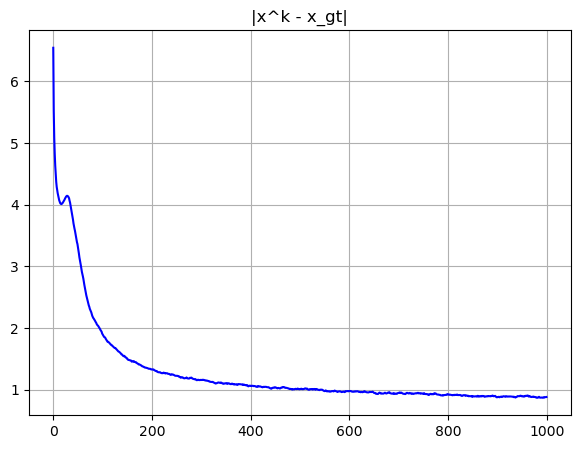

tensor(6.5456, dtype=torch.float64)


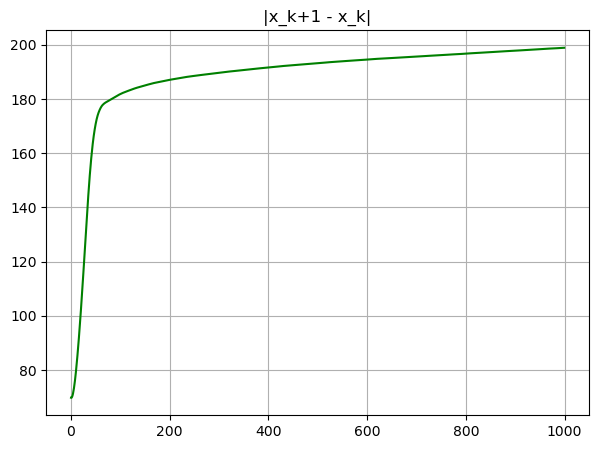

In [6]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

### optimization with tv regularization

[W NNPACK.cpp:64] Could not initialize NNPACK! Reason: Unsupported hardware.


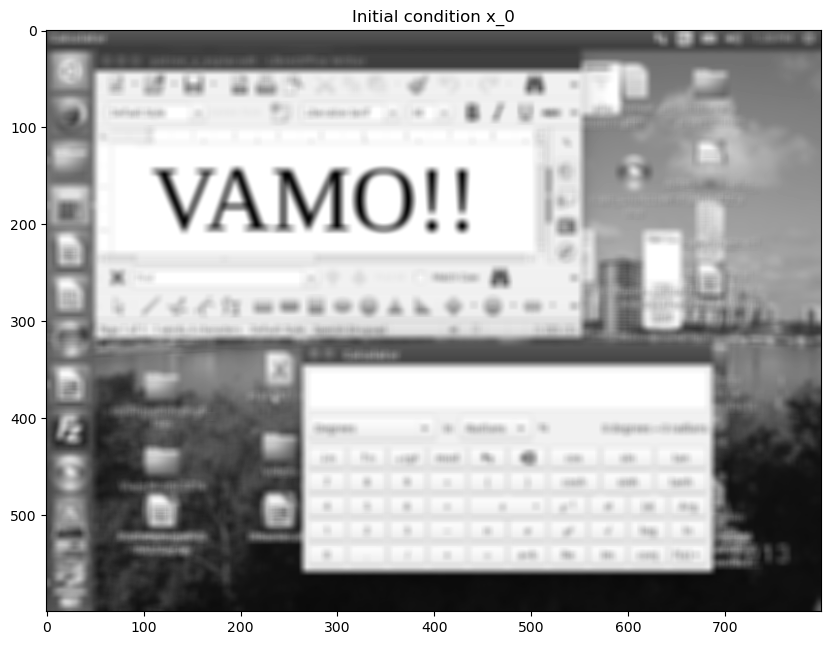

objective function = 8181.74365234375
diff_x_gt: 1.0791642199235112
diff_x: 87.26059255572372
-----------


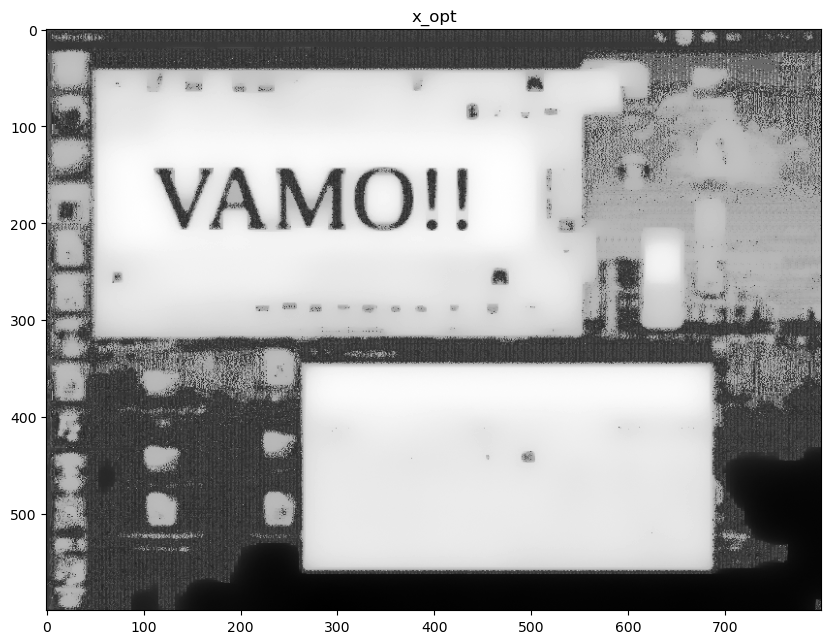

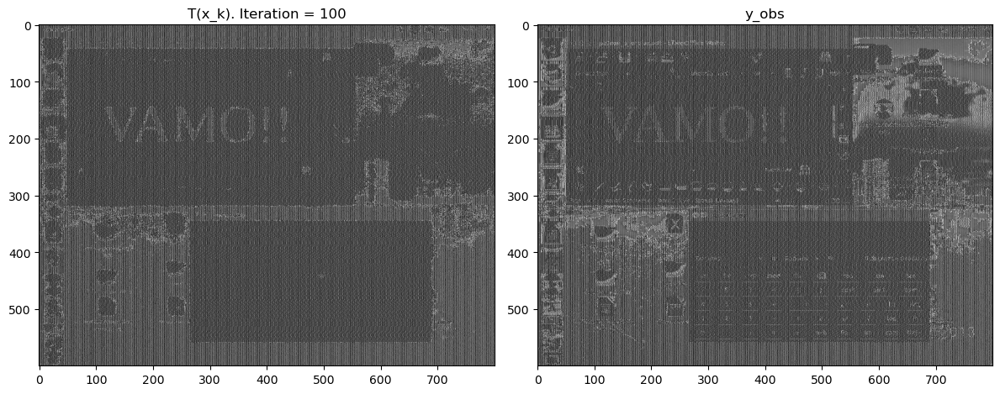

<Figure size 640x480 with 0 Axes>

objective function = 8131.57861328125
diff_x_gt: 0.9631029966887363
diff_x: 91.29707210885732
-----------


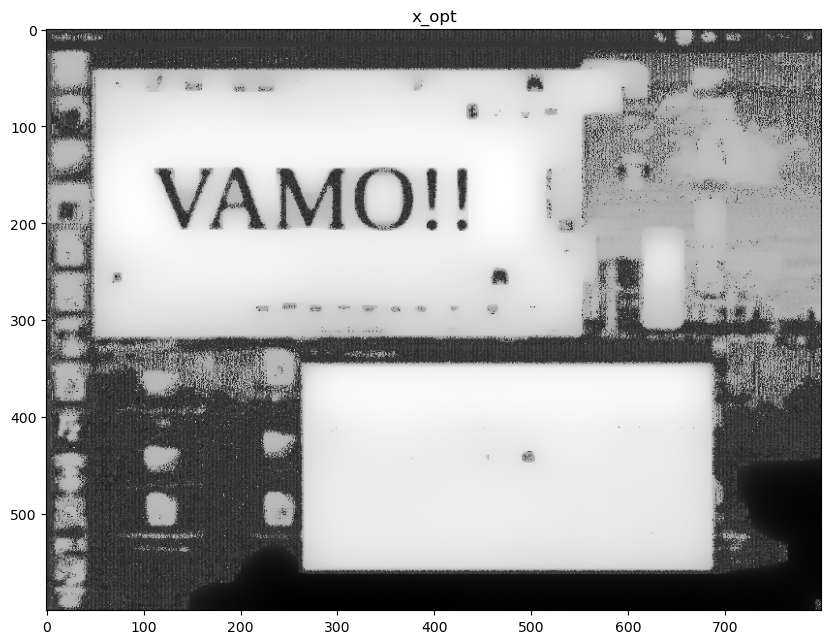

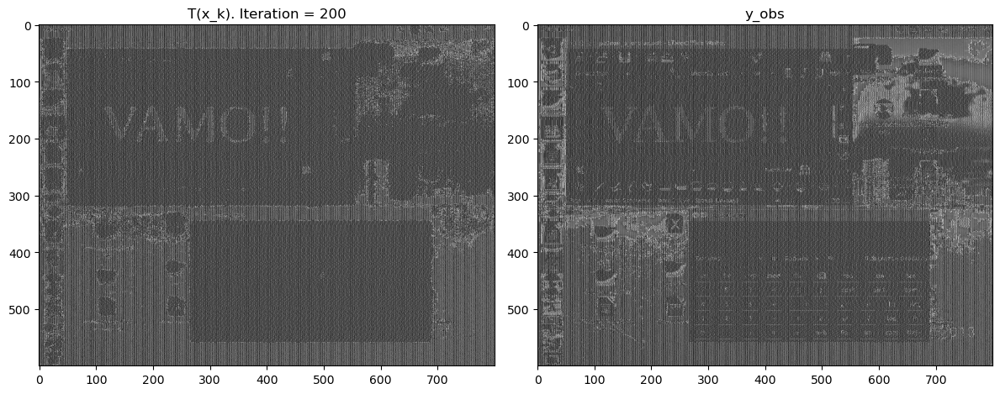

<Figure size 640x480 with 0 Axes>

In [5]:
#optimization with total variation regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
x_gt = x_gt.unsqueeze(0)
x_0 = gaussian_blur(x_gt, kernel_size = (9,9), sigma = 5.0)
x_gt = x_gt.squeeze(0)
x_0 = x_0.squeeze(0)
#x_0 = torch.zeros_like(x_gt)

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 200, eps = 1e-4, lr = 0.01, reg = 'tv', lam = 1e-9, k_print = 100 )

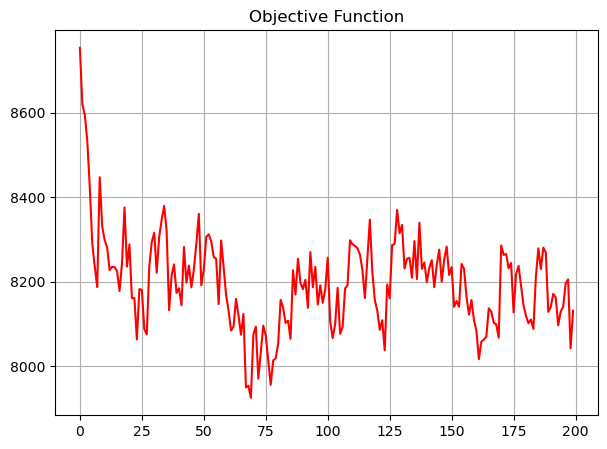

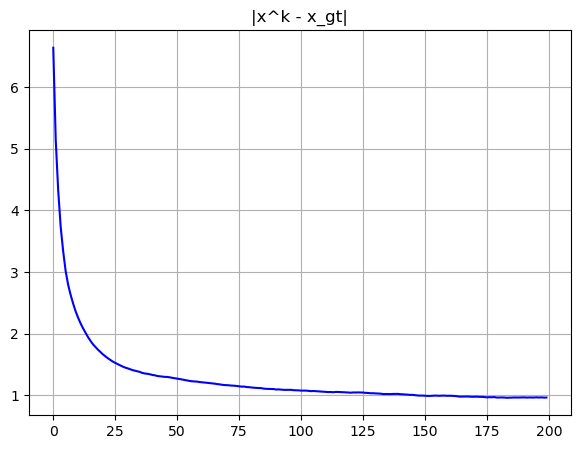

tensor(6.6381, dtype=torch.float64)


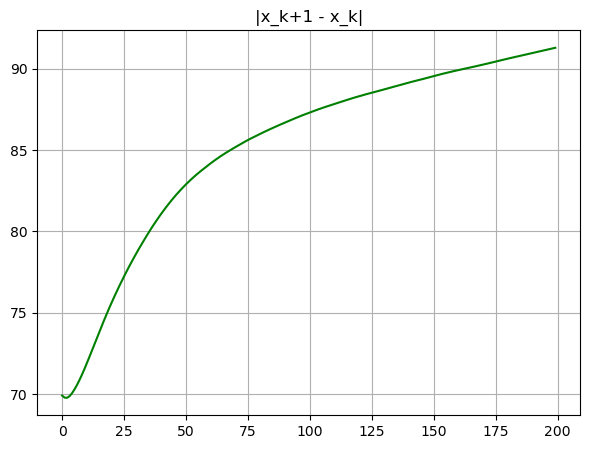

In [6]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()

### optimization with l2 regularization

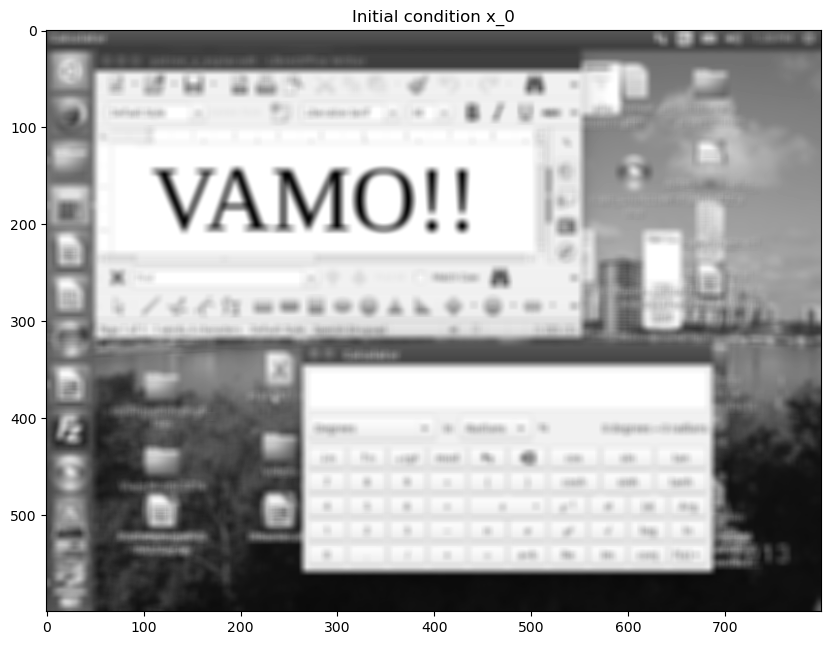

objective function = 8008.585856016119
diff_x_gt: 1.9114102312469687
diff_x: 181.6516270757771
-----------


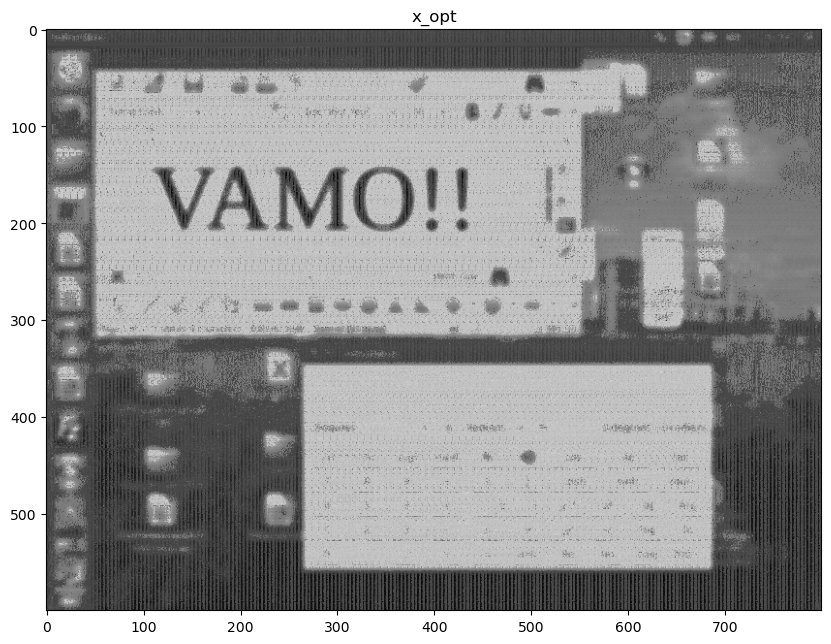

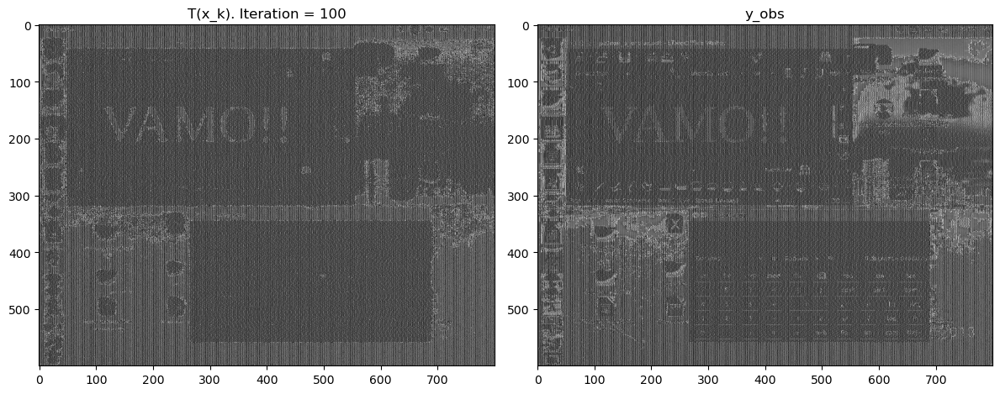

<Figure size 640x480 with 0 Axes>

objective function = 7883.018477921819
diff_x_gt: 1.3263889471083432
diff_x: 186.7489296930586
-----------


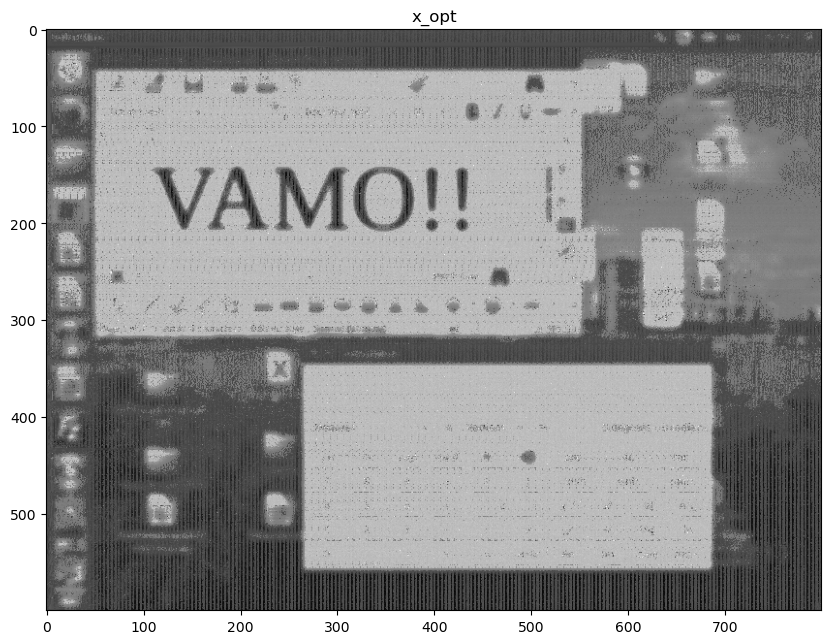

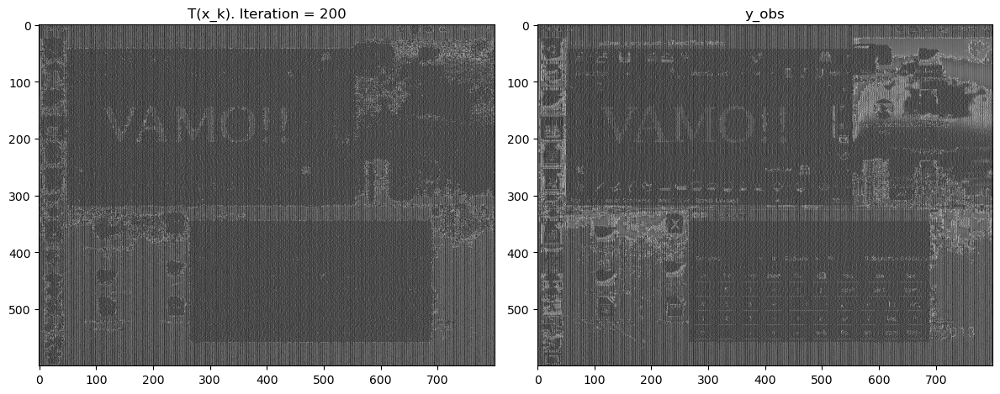

<Figure size 640x480 with 0 Axes>

In [7]:
#optimization with l2 regularization
x_gt = torch.tensor(imread(os.path.join("./imagenes", "VAMO.png"), as_gray=True), requires_grad= True)
x_gt = x_gt.unsqueeze(0)
x_0 = gaussian_blur(x_gt, kernel_size = (9,9), sigma = 5.0)
x_gt = x_gt.squeeze(0)
x_0 = x_0.squeeze(0)
#x_0 = torch.zeros_like(x_gt)

x_opt_final, OF_record, diff_x_gt_record, diff_x_record = optimize_hdmi(x_gt, x_0, max_iter = 200, eps = 1e-4, lr = 0.01, reg = 'l2', lam = 1e-9, k_print = 100 )

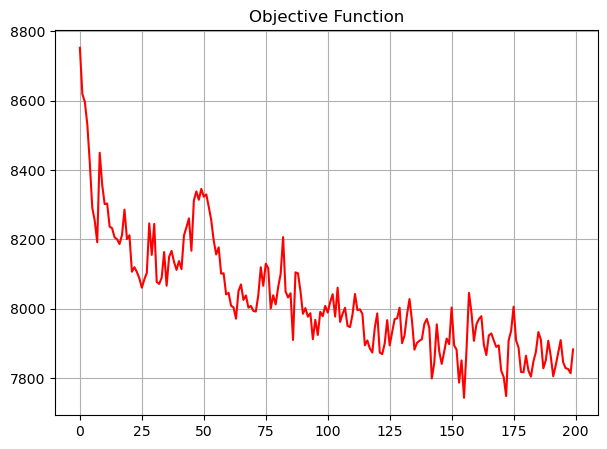

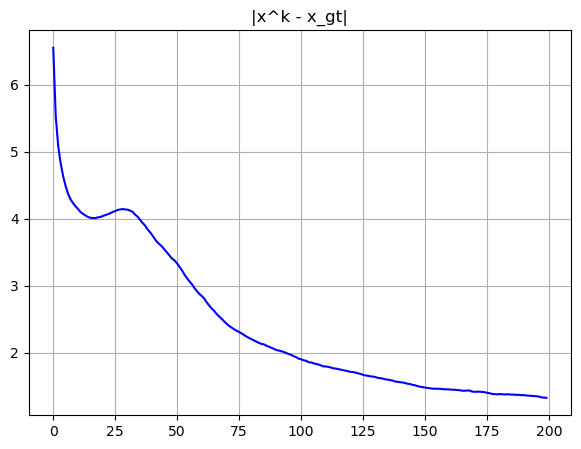

tensor(6.5501, dtype=torch.float64)


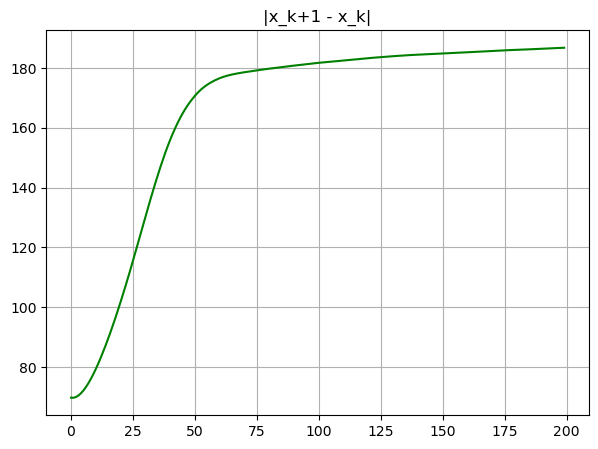

In [8]:
inicio = 0

plt.figure(figsize = (7,5))
plt.plot(OF_record[inicio:], 'r')
plt.grid()
plt.title('Objective Function')
plt.show()

plt.figure(figsize = (7,5))
plt.plot(diff_x_gt_record[inicio:], 'b')
plt.grid()
plt.title('|x^k - x_gt|')
plt.show()
print(diff_x_gt_record[0])

plt.figure(figsize = (7,5))
plt.plot(diff_x_record[inicio:], 'g')
plt.grid()
plt.title('|x_k+1 - x_k|')
plt.show()